# Imports

Estas son todas las librerias necesarias para la ejecución del cuaderno.

In [1]:
import os

import numpy as np
import matplotlib.pyplot as plt
import random
import cv2
import glob
import time
import visualkeras

from PIL import ImageFont

from keras.layers import Add
from tensorflow.nn import depth_to_space

from tensorflow.keras.utils import plot_model
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, Dense, Activation, Flatten, Reshape, Dropout, BatchNormalization
from tensorflow.keras.layers import LeakyReLU

from sklearn.model_selection import train_test_split

# Carga & Preprocesado de datos

Vamos a utilizar Google Drive para cargar nuestro Dataset y trabajar con él, asi que debemos hacer un mount del Drive para usarlo.

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


Definimos variables globales la facilitar la exploración de datos y el almacenamiento de los futuros pesos del modelo.

In [3]:
PATH_GRUPO_MG = '/content/drive/MyDrive/Colab Notebooks/Grupo MG/'
PATH_MODELOS = PATH_GRUPO_MG + '/Modelos/'

PATH_DATASET = '/content/drive/MyDrive/dataset/MedicasRX_Normals'

La función **crop_center** realiza un corte cuadrado en el centro de la imagen. Esto nos ayuda a que las imagenes tengan la misma forma, y además nos quedamos con el centro de la misma que es donde se encuentran las características más importantes.

In [4]:
def crop_center(image, m):
    # Dimensiones de la imagen
    original_height, original_width = image.shape[:2]

    # Calculamos las coordenadas del crop
    left = (original_width - m) // 2
    top = (original_height - m) // 2
    right = (original_width + m) // 2
    bottom = (original_height + m) // 2

    return image[top:bottom, left:right]

**Load** transforma las imagenes para que sean acorde a lo que buscamos, usa **crop_center** para recortarlas y despues jugamos con el tamaño haciendo uso de openCV.

Las imagenes de baja calidad las construimos cogiendo las originales y haciendolas más pequeñas para luego aumentarlas, así obtenemos un buen efecto de pixelación y desenfoque.

In [5]:
def load(path,shape,low):
    if (low):
      img= cv2.imread(path)
      img= cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

      m = min(img.shape[0], img.shape[1])

      # Crop del centro de la imagen
      img = crop_center(img, m)

      img= cv2.resize(img, (50, 50))
      img= cv2.resize(img, shape)

    else:
      img= cv2.imread(path)
      img= cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

      m = min(img.shape[0], img.shape[1])

      # Crop del centro de la imagen
      img = crop_center(img, m)

      img= cv2.resize(img, shape)

    return img

Cargamos las imagenes desde Drive y llamamos a las funciones anteriores para procesarlas.

In [6]:
shape = (150, 150)

def get_data(directory):
    X = []
    y = []
    for folder in glob.glob(directory+ str('/*')):
        for img_path in glob.glob(folder+ str('/*')):
            X.append(load(img_path, shape, False))
            y.append(load(img_path, shape, True))

    X = np.array(X)
    y = np.array(y)
    return X, y

Este es el resultado, 1578 imagenes de alta resolución y de baja resolución. Un total de 3156 imagenes de 150x150 en blanco y negro.

In [7]:
HR_train, LR_train = get_data(PATH_DATASET)
HR_train.shape, LR_train.shape

((1578, 150, 150), (1578, 150, 150))

Procesamos las datos y divimos las muestras para generar el conjunto de datos necesario durante los entrenamientos y las futuras predicciones.

In [8]:
X_train_low, X_test_low, X_train, X_test = train_test_split(LR_train, HR_train, test_size=0.2)
X_train_low.shape, X_test_low.shape, X_train.shape, X_test.shape

((1262, 150, 150), (316, 150, 150), (1262, 150, 150), (316, 150, 150))

Aquí tenemos un plot con las imagenes de alta resolucion. Como podemos observar las imagenes son de carácter médico. Estamos trabajando con imagenes del cortex cerebral y torsos.

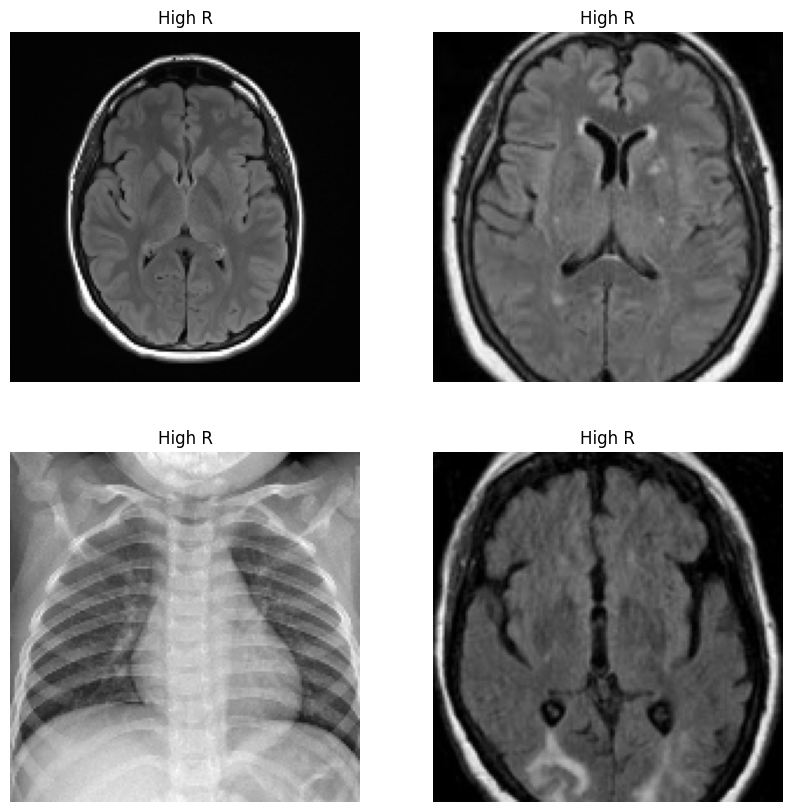

In [9]:
rand = random.randint(0, 200)

plt.figure(figsize=(10, 10))
for i in range(4):
    plt.subplot(2, 2, i + 1)
    plt.title("High R")
    plt.imshow(X_train[i+rand], cmap='gray')
    plt.axis("off")

Estas son imagenes de nuestro conjunto de datos de baja resolución que nuestro modelo tendrá que mejorar.

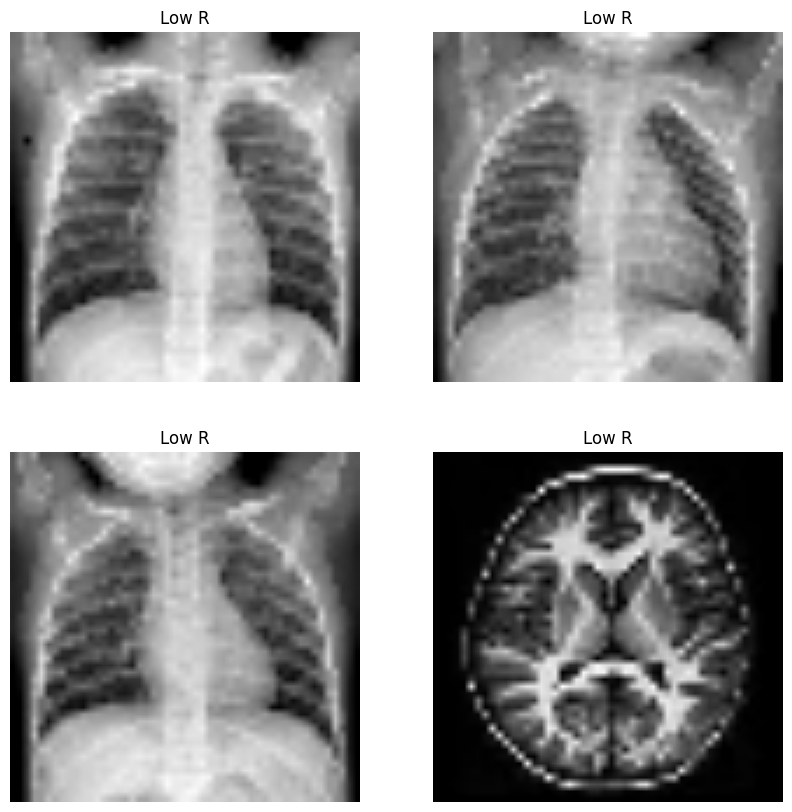

In [10]:
rand = random.randint(0, 200)

plt.figure(figsize=(10, 10))
for i in range(4):
    plt.subplot(2, 2, i + 1)
    plt.title("Low R")
    plt.imshow(X_train_low[i+rand], cmap='gray')
    plt.axis("off")

Por último, vamos a normalizar las imagenes entre `[-1,1]`.

In [11]:
X_train     = X_train.astype('float32')/127.5 -1
X_train_low = X_train_low.astype('float32')/127.5 -1
X_test      = X_test.astype('float32')/127.5 -1
X_test_low  = X_test_low.astype('float32')/127.5 -1

In [12]:
shape = X_train_low.shape[1:]
shape

(150, 150)

# Diseño de la arquitectura

Tras consultar diferentes papers y estudios finalmente nos hemos inspirado en una arquitectura ESRGAN y SRGAN para modelar nuestra solución.

Uno de los [paper](https://arxiv.org/pdf/1609.04802v5.pdf) que hemos tenido como base explica de una manera detallada la arquitectura a través de esta foto:

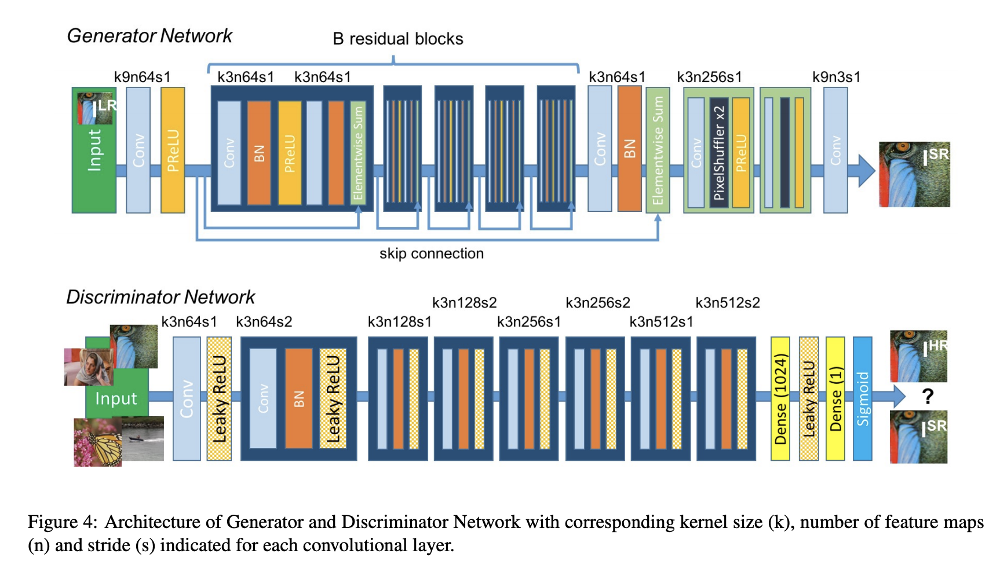

Nosotros trataremos de modificarla y adaptarla hasta lograr nuestro objetivo.

## Generator definition

Hemos establecido como parámetro global el número de **filtros**, este es de **64** ya que es el número que mejor resultados nos ha dado.

Cuenta con 7 bloques residuales, los cuales tienes 2 capas convulucionales con BatchNormalization y LeakyReLU, cada capa residual por definición cuanta con una skip connection implementando un **ResNet**.

Por otro lado, hemos implementado bloques finales con una convulución y pixel shuffle que es una técnica muy utilizada durante la super resolución que permite implementar convoluciones de subpíxeles eficientes durante el paso de los strides.

A parte de estas peculiaridades, el resto es similar a las GANs vistas en clase.

In [13]:
N_FILTERS = 64

def resBlock(prev, f, kernel_size, strides):
    x = Conv2D(f, kernel_size, strides, padding='same')(prev)
    x = BatchNormalization(momentum=0.8)(x)
    x = LeakyReLU(alpha=0.01)(x)

    x = Conv2D(f, kernel_size, strides, padding='same')(x)
    x = BatchNormalization(momentum=0.8)(x)
    x = LeakyReLU(alpha=0.01)(x)

    return Add()([x, prev])

def endBlock(prev, f, kernel_size, strides):
    x = Conv2D(f, kernel_size, strides, padding='same')(prev)

    # Pixel shuffle x2
    x = depth_to_space(x, 2)

    return LeakyReLU(alpha=0.01)(x)

def create_generator():
    input = Input((shape[0], shape[1], 1))

    # Convolución inicial
    x = Conv2D(N_FILTERS, padding='same', kernel_size=5, strides=1)(input)
    x = LeakyReLU(alpha=0.01)(x)

    # Bloques residuales
    for _ in range(7):
      x1 = resBlock(x,  N_FILTERS, kernel_size=5, strides=1)

    x1 = Conv2D(N_FILTERS, padding='same', kernel_size=3, strides=1)(x1)
    x1 = LeakyReLU(alpha=0.01)(x1)

    x = Add()([x, x1])

    # Bloques finales
    x = endBlock(x, N_FILTERS, kernel_size=3, strides=1)

    for _ in range(2):
      x = endBlock(x, N_FILTERS, kernel_size=3, strides=2)


    # Convolución final
    output = Conv2D(1, padding='same', kernel_size=3, strides=2, activation='tanh')(x)

    generator = Model(input, output)

    return generator

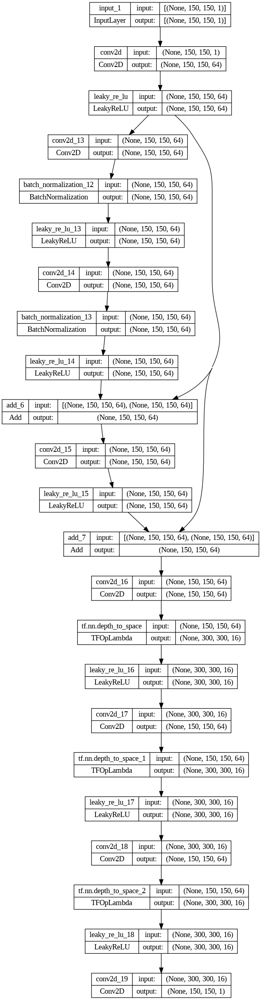

In [14]:
generator = create_generator()
plot_model(generator, show_shapes=True, show_layer_names=True)

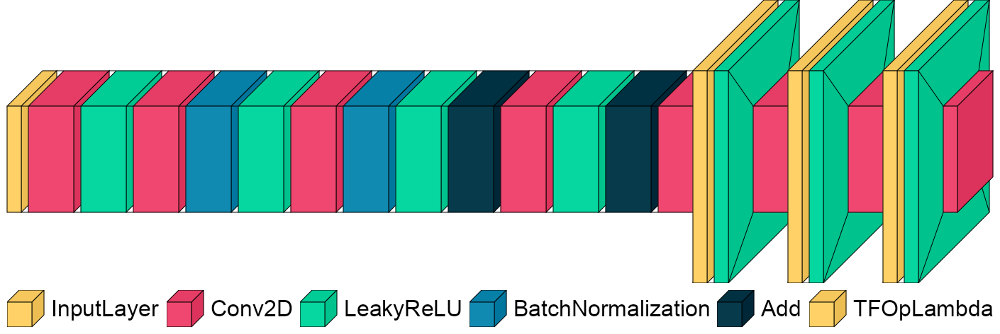

In [ ]:
font = ImageFont.truetype("arial.ttf", 32)
visualkeras.layered_view(generator, scale_xy=1, scale_z=1, max_z=250, font=font, legend=True)

## Discriminator definition

Usando como refencia el paper, hemos creado nuestro propio discriminador, cuanta con 3 bloques de convuluciones, batchnormalization, dropout, leackyReLU y strides a 1. También tiene 3 convuluciones más con strides a 2 y una capa final Flatten que conecta con nuestra capa densa que permite generar la salida sigmoidal del discrimador.

In [15]:
N_FILTERS = 16

def discBlock(prev):
  x = Conv2D(N_FILTERS, kernel_size=3, strides=1, padding="same")(prev)
  x = BatchNormalization(momentum=0.8)(x)
  x = Dropout(0.5)(x)
  return LeakyReLU(alpha=0.01)(x)

def create_discriminator():
    input = Input((shape[0], shape[1], 1))

    x = Conv2D(N_FILTERS, kernel_size=3, strides=2, padding="same")(input)
    x = Dropout(0.5)(x)
    x = LeakyReLU(alpha=0.01)(x)

    for _ in range(3):
      x = discBlock(x)

    x = Conv2D(N_FILTERS, kernel_size=3, strides=2, padding="same")(x)
    x = BatchNormalization(momentum=0.8)(x)
    x = Dropout(0.5)(x)
    x = LeakyReLU(alpha=0.01)(x)

    x = Conv2D(N_FILTERS, kernel_size=3, strides=2, padding="same")(x)
    x = Dropout(0.5)(x)
    x = LeakyReLU(alpha=0.01)(x)

    x = Flatten()(x)

    x = Dense(1024)(x)
    x = LeakyReLU(alpha=0.01)(x)
    output = Dense(1, activation='sigmoid')(x)

    return Model(input, output)

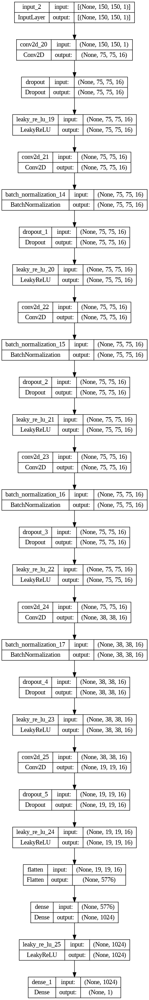

In [16]:
discriminator = create_discriminator()
plot_model(discriminator, show_shapes=True, show_layer_names=True)

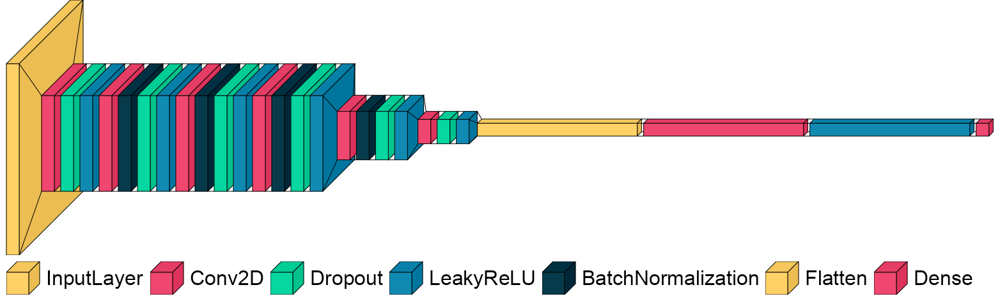

In [ ]:
font = ImageFont.truetype("arial.ttf", 32)
visualkeras.layered_view(discriminator, scale_xy=2, scale_z=1, max_z=250, font=font, legend=True)

## GAN model definition

Compilamos los modelos y preparamos el modelo combinado para el entrenamiento.

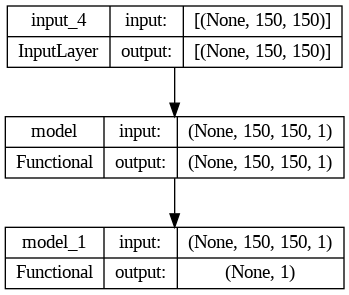

In [ ]:
discriminator.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
discriminator.trainable = False

z = Input(shape)

img = generator(z)
validity = discriminator(img)

combined = Model(z, validity)
combined.compile(loss='mse', optimizer='adam')

plot_model(combined, show_shapes=True, show_layer_names=True)

# Training

## Método de entrenamiento

Hemos reutilizado el Training de las prácticas de GANs hechas en clase, le pasamos al generador imagenes de baja calidad y el discriminador recibe las de baja y alta calidad.

In [ ]:
def train(X_train, generator, discriminator, combined, epochs, batch_size=32, sample_interval=100):
    # Adversarial ground truths (-1 fake and 1 real)
    valid = np.ones((batch_size, 1))
    fake = np.zeros((batch_size, 1))

    history = {
        'd_loss' : [],
        'd_acc' : [],
        'g_loss' : []
    }

    for epoch in range(epochs):
        start_time = time.time()

        print("----EPOCH " + str(epoch) + '-----')
        for batch in range(int(len(X_train)/batch_size)):
            #  Train the Discriminator
            imgs_low = X_train_low[batch*batch_size : (batch+1)*batch_size]

            # El generador ahora deberá admitir el noise la mismo tiempo que los gen_labels generados aleatoriamente
            gen_imgs = generator.predict(imgs_low, verbose=0)
            imgs_high = X_train[batch*batch_size : (batch+1)*batch_size]

            # Añadir a las salidas deseadas del discriminador las etiquetas aleatorias y las obtenidas de y_train
            d_loss_real = discriminator.train_on_batch(imgs_high, valid)
            d_loss_fake = discriminator.train_on_batch(gen_imgs, fake)
            d_loss = 0.5 * np.add(d_loss_real, d_loss_fake)

            # Train the Generator
            # Añadir como entrada y salida las etiquetas generadas
            g_loss = combined.train_on_batch(imgs_low, valid)

            # Save losses
            history['d_loss'].append(d_loss[0])
            history['d_acc'].append(d_loss[1])
            history['g_loss'].append(g_loss)

            # Plot the progress
            if batch % 50 == 0:
                print ("%d [D loss: %.4f,\t acc.: %.2f%%]\t[G loss: %.4f]" % (batch, d_loss[0], 100*d_loss[1], g_loss))
                print("Execution time: " + str(time.time() - start_time))

            if batch % 100 == 0:
                sample_images(epoch, batch, gen_imgs, imgs_high, imgs_low)

        # Guardar pesos
        generator    .save_weights(PATH_MODELOS + 'gen_alejandro.keras')
        discriminator.save_weights(PATH_MODELOS + 'disc_alejandro.keras')
        combined     .save_weights(PATH_MODELOS + 'comb_alejandro.keras')

        plot_losses(history)

## Plotting functions

Funciones de muestreo para monitorizar el training.

In [ ]:
def sample_images(epoch, batch, gen_imgs, imgs, imgs_low):
    plt.rcParams['figure.figsize'] = [25, 5]
    fig, axs = plt.subplots(3, 10)
    fig.suptitle('Epoch: ' + str(epoch) + ', Batch: ' + str(batch), fontsize=16)

    for i in range(10):
        axs[0,i].imshow(gen_imgs[i,:,:], cmap='Greys')
        axs[0,i].axis('off')

    for i in range(10):
        axs[1,i].imshow(imgs[i,:,:], cmap='Greys')
        axs[1,i].axis('off')

    imgs_low = imgs_low.reshape(imgs.shape[0], shape[0], shape[1])

    for i in range(10):
        axs[2,i].imshow(imgs_low[i,:,:], cmap='Greys')
        axs[2,i].axis('off')

    plt.show()
    plt.close()

In [ ]:
def plot_losses(history):
    plt.rcParams['figure.figsize'] = [20, 5]
    f, (ax1, ax2) = plt.subplots(1, 2, sharex=True)

    ax1.set_title('Losses')
    ax1.set_xlabel('epoch')
    ax1.legend(loc="upper right")
    ax1.grid()

    ax1.plot(history['d_loss'], label='D loss')
    ax1.plot(history['g_loss'], label='G loss')
    ax1.legend()

    ax2.set_title('D accuracy')
    ax2.set_xlabel('epoch')
    ax2.legend(loc="upper right")
    ax2.grid()

    ax2.plot(history['d_acc'], label='Accuracy')
    ax2.legend()

    plt.show()

Función que permite cargar los pesos que vamos guardando durante los epoch.

In [ ]:
_, _, files = next(os.walk(PATH_MODELOS))

if len(files) > 0:
  generator    .load_weights(PATH_MODELOS + 'gen_alejandro.keras')
  discriminator.load_weights(PATH_MODELOS + 'disc_alejandro.keras')
  combined     .load_weights(PATH_MODELOS + 'comb_alejandro.keras')

  print("Pesos cargados")

----EPOCH 0-----
0 [D loss: 2.0563,	 acc.: 42.19%]	[G loss: 0.1666]
Execution time: 38.995129108428955


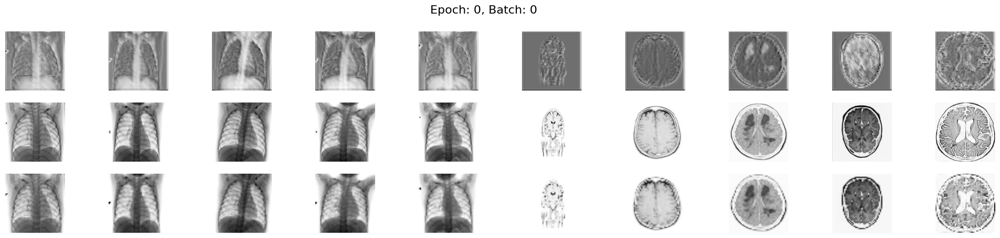

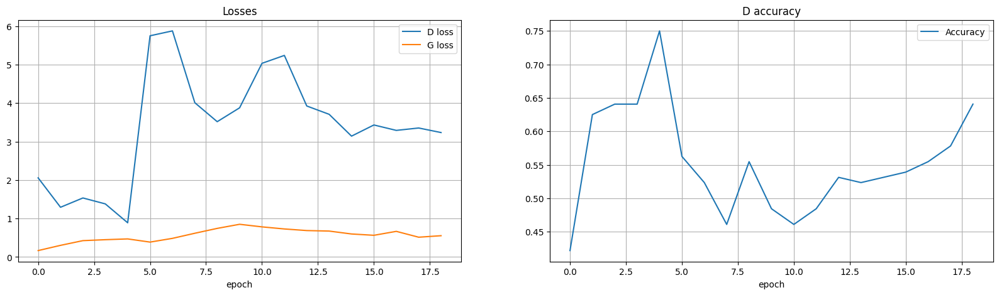

----EPOCH 1-----
0 [D loss: 4.1248,	 acc.: 57.81%]	[G loss: 0.3549]
Execution time: 1.2751383781433105


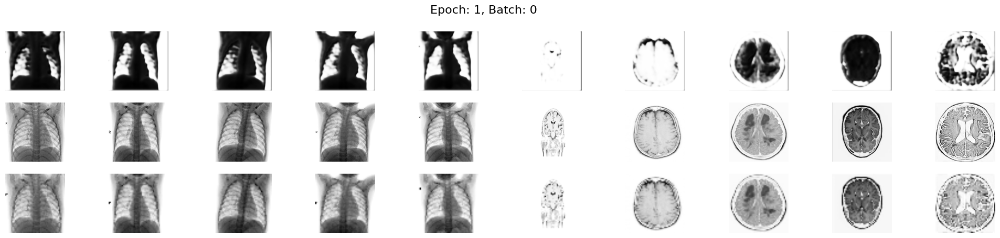

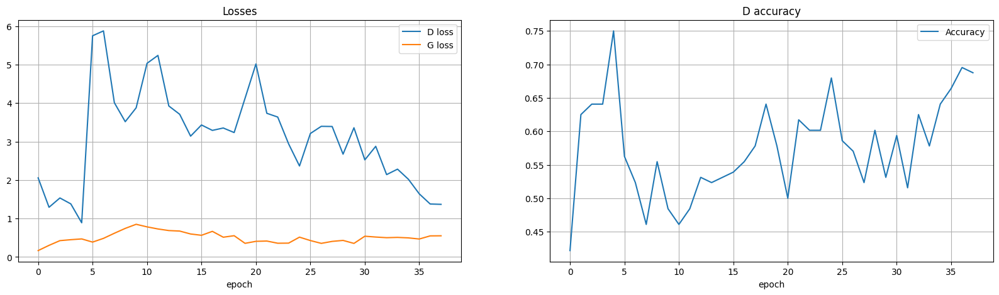

----EPOCH 2-----
0 [D loss: 1.1821,	 acc.: 67.19%]	[G loss: 0.3974]
Execution time: 1.286745548248291


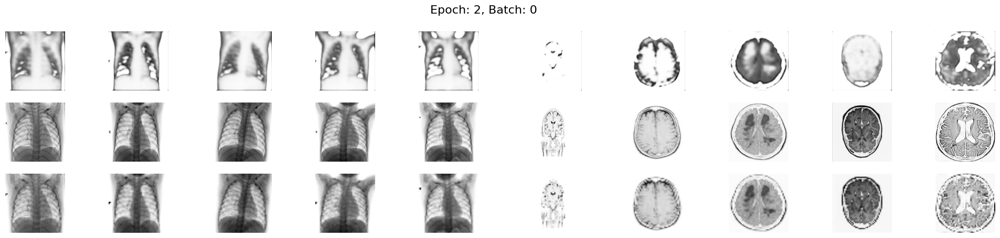

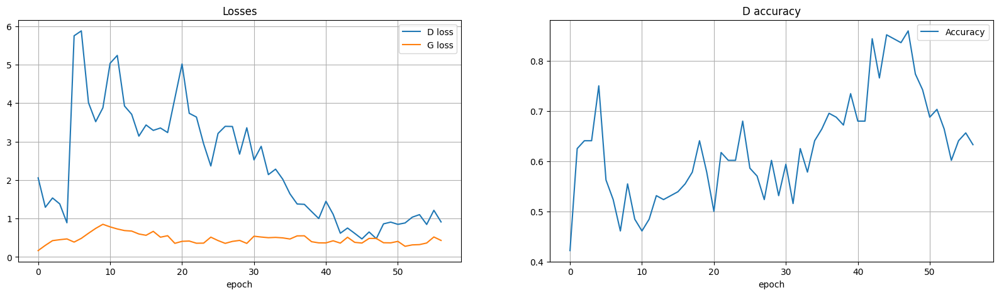

----EPOCH 3-----
0 [D loss: 0.9505,	 acc.: 60.16%]	[G loss: 0.3707]
Execution time: 1.3029963970184326


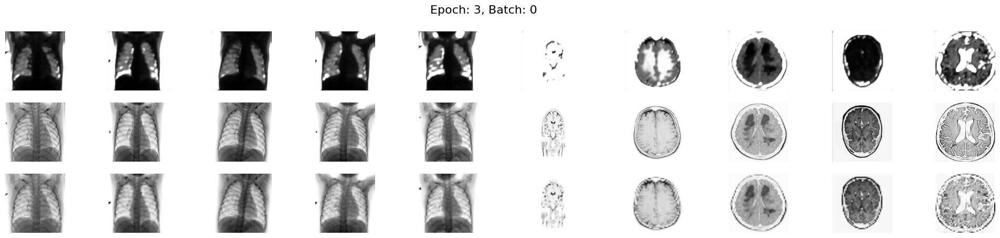

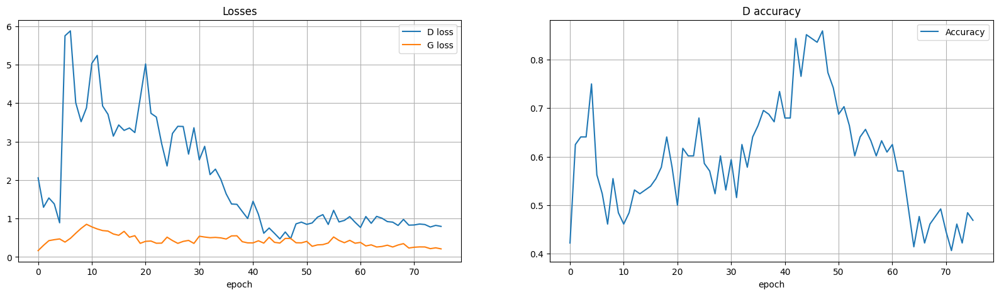

----EPOCH 4-----
0 [D loss: 0.7576,	 acc.: 49.22%]	[G loss: 0.2838]
Execution time: 1.2991340160369873


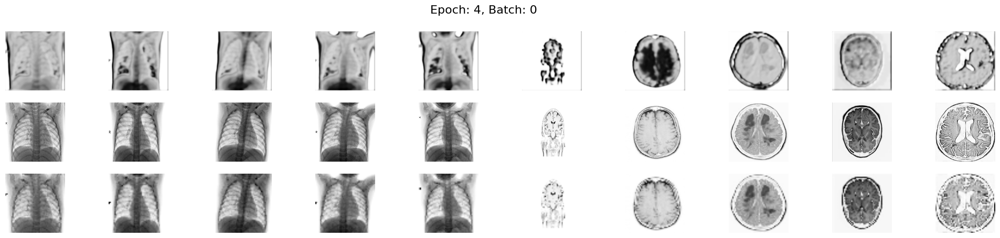

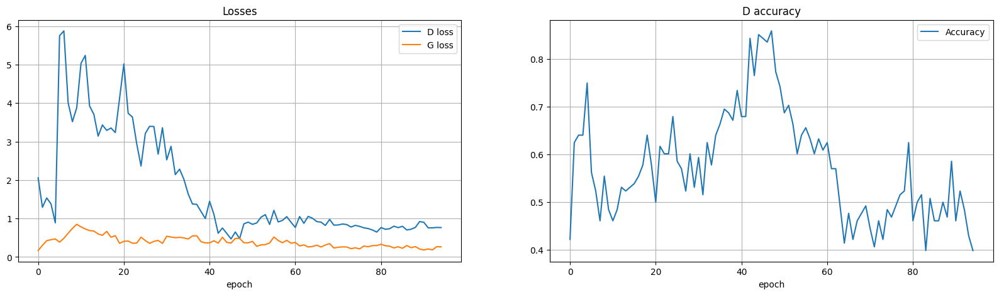

----EPOCH 5-----
0 [D loss: 0.7468,	 acc.: 48.44%]	[G loss: 0.2273]
Execution time: 1.36979341506958


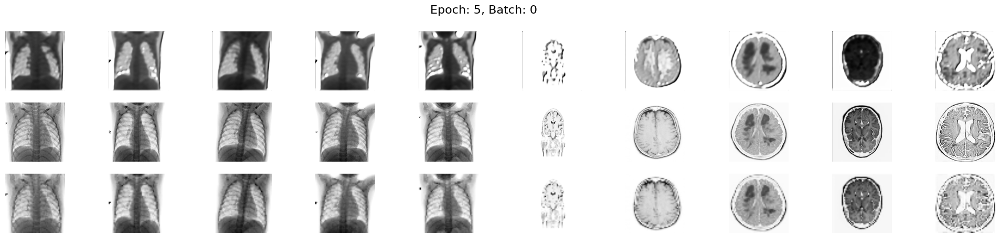

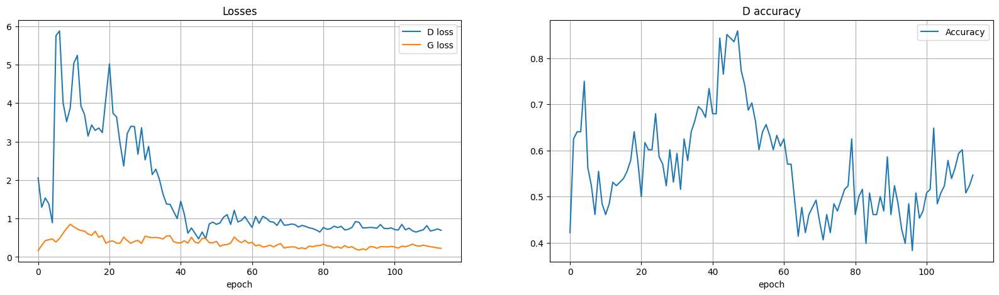

----EPOCH 6-----
0 [D loss: 0.7232,	 acc.: 53.12%]	[G loss: 0.2214]
Execution time: 1.3782589435577393


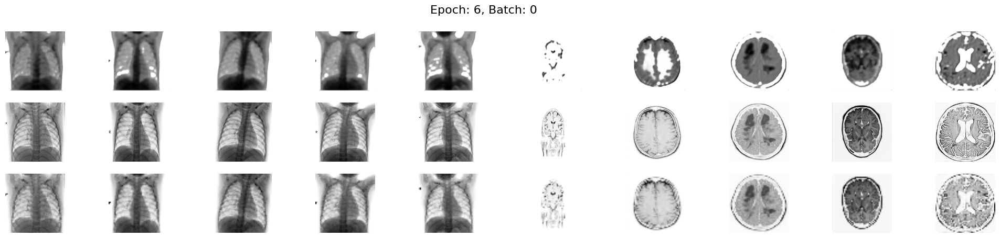

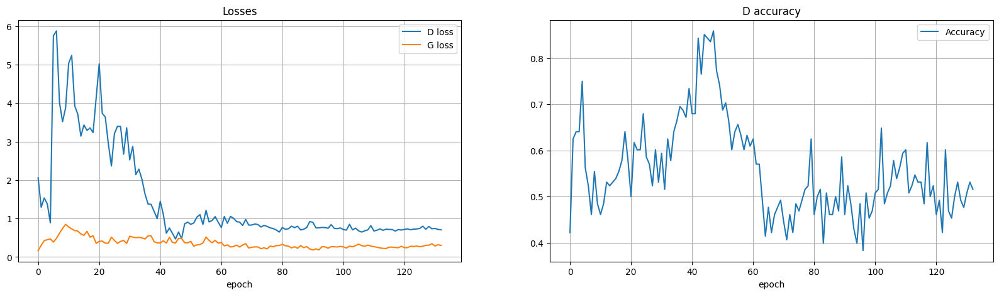

----EPOCH 7-----
0 [D loss: 0.7595,	 acc.: 57.81%]	[G loss: 0.4829]
Execution time: 1.3136634826660156


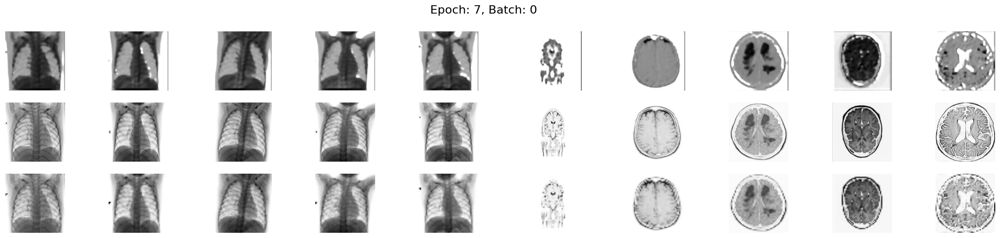

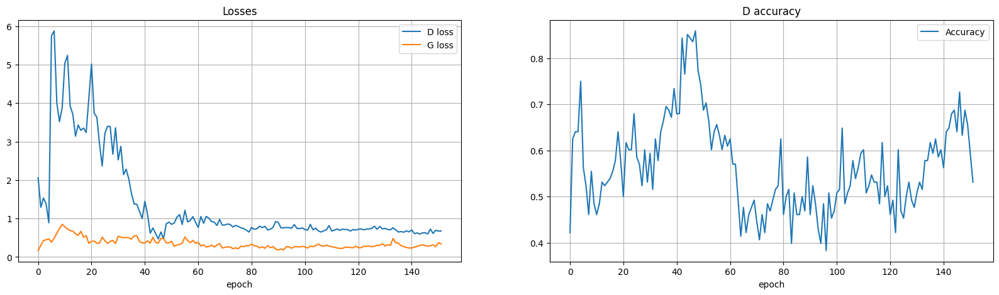

----EPOCH 8-----
0 [D loss: 0.6646,	 acc.: 60.94%]	[G loss: 0.3328]
Execution time: 1.3400700092315674


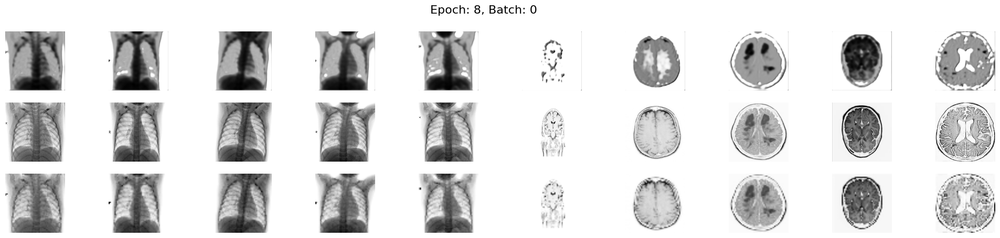

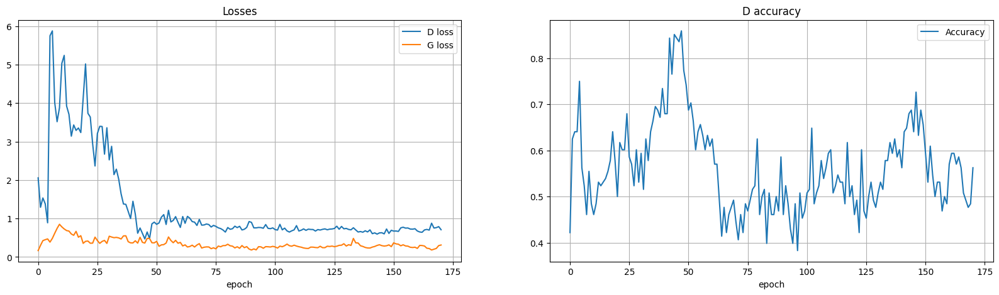

----EPOCH 9-----
0 [D loss: 0.6926,	 acc.: 63.28%]	[G loss: 0.3436]
Execution time: 1.7341444492340088


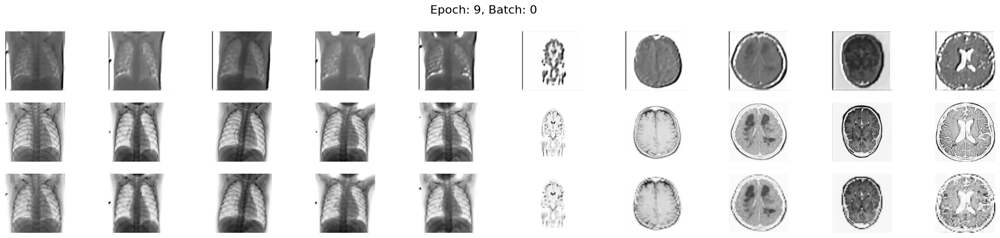

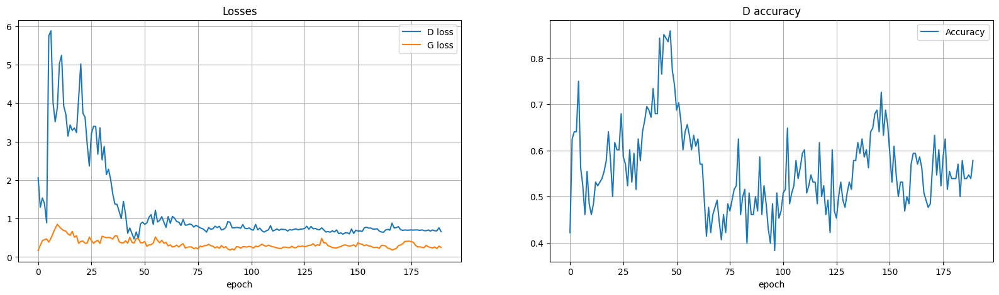

----EPOCH 10-----
0 [D loss: 0.6886,	 acc.: 57.81%]	[G loss: 0.2399]
Execution time: 1.8879265785217285


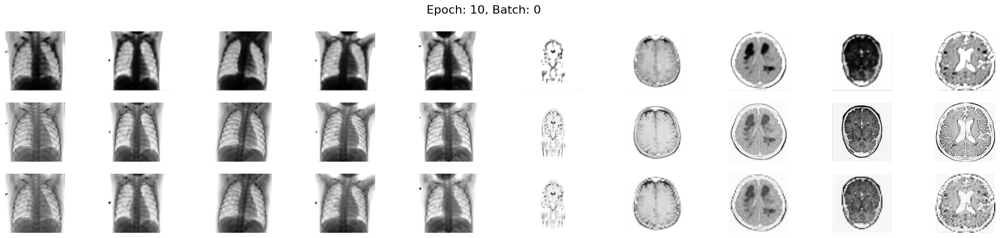

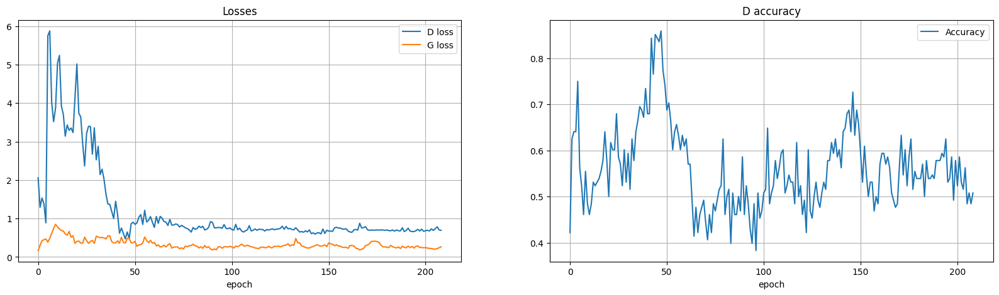

----EPOCH 11-----
0 [D loss: 0.7100,	 acc.: 48.44%]	[G loss: 0.2133]
Execution time: 1.4097716808319092


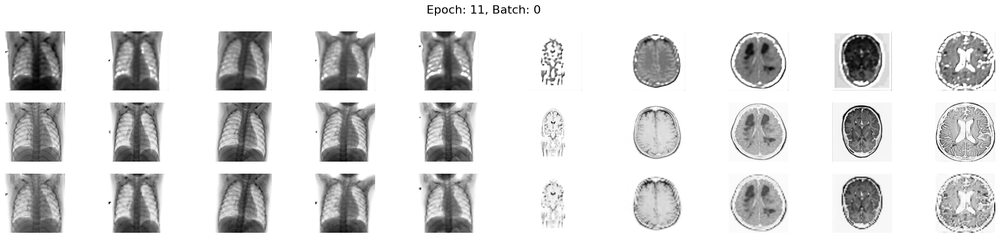

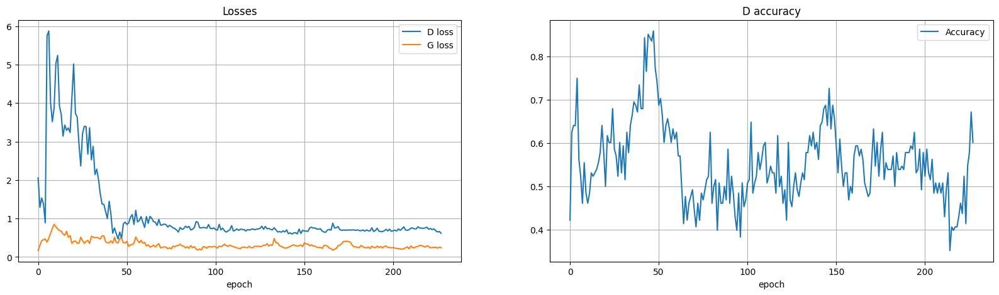

----EPOCH 12-----
0 [D loss: 0.6491,	 acc.: 62.50%]	[G loss: 0.2393]
Execution time: 1.3723163604736328


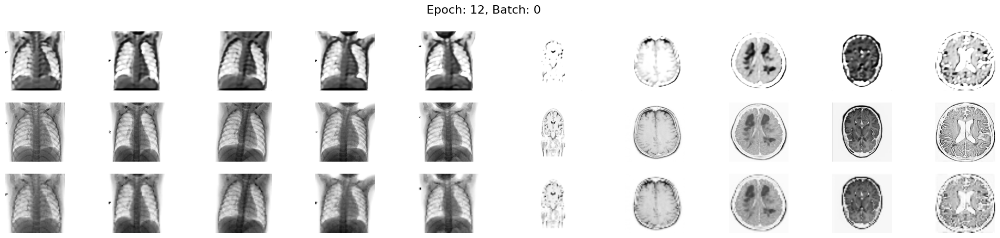

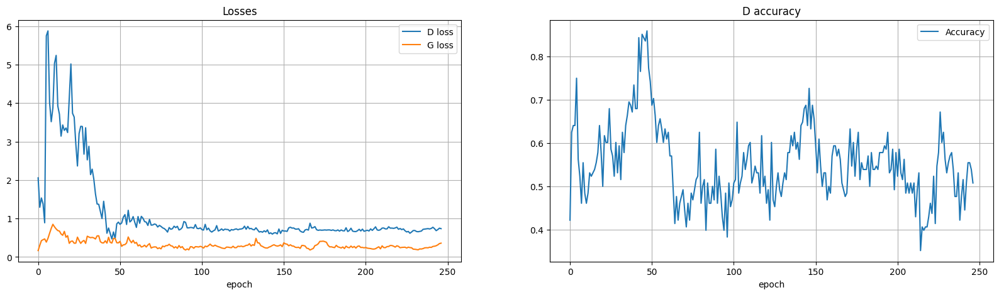

----EPOCH 13-----
0 [D loss: 0.6783,	 acc.: 57.03%]	[G loss: 0.3317]
Execution time: 1.4621984958648682


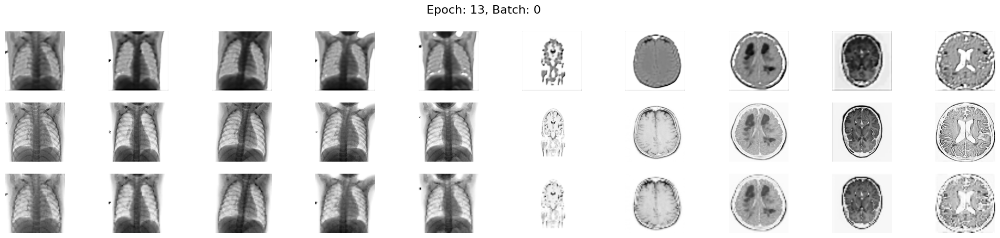

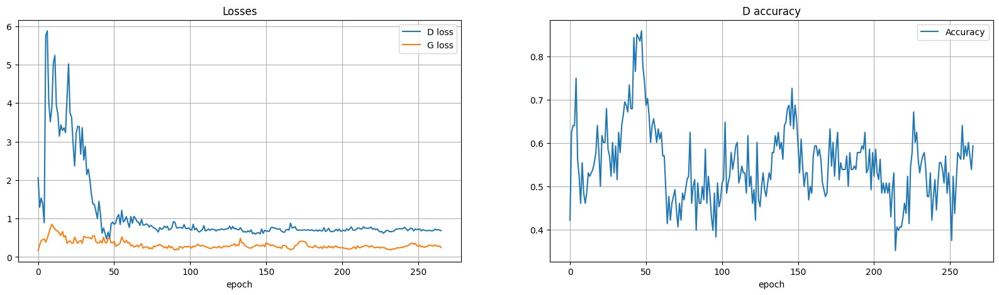

----EPOCH 14-----
0 [D loss: 0.7020,	 acc.: 52.34%]	[G loss: 0.2390]
Execution time: 1.3441524505615234


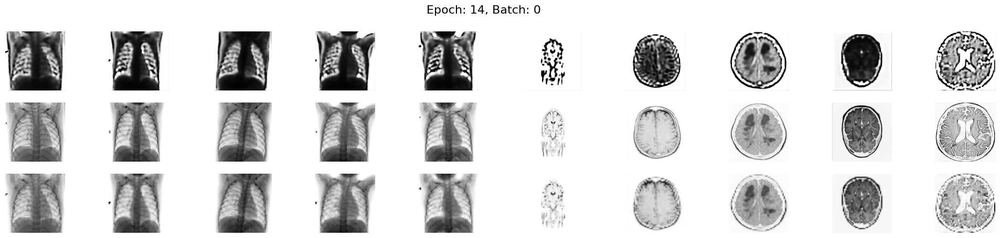

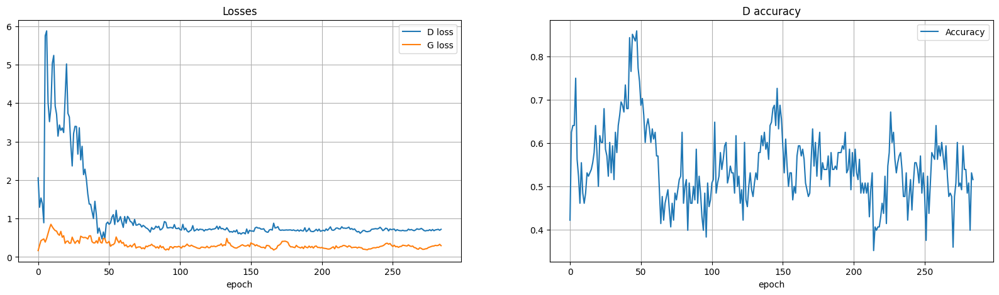

----EPOCH 15-----
0 [D loss: 0.7049,	 acc.: 42.97%]	[G loss: 0.2544]
Execution time: 1.3436763286590576


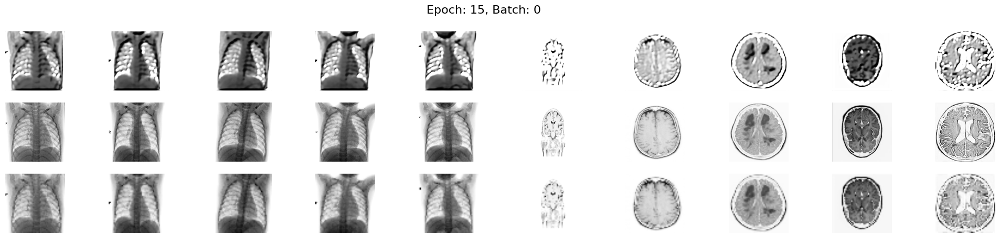

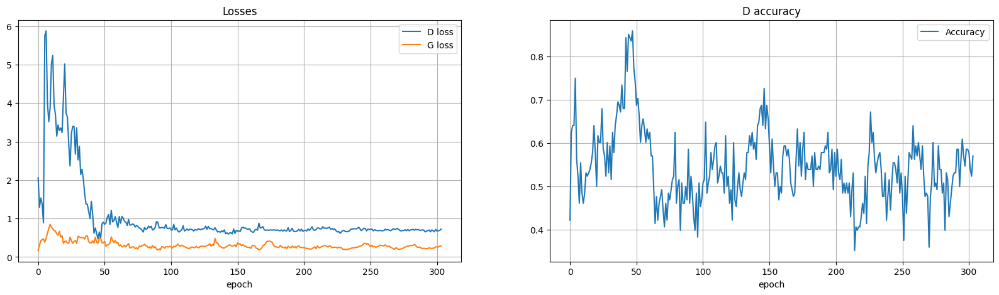

----EPOCH 16-----
0 [D loss: 0.7086,	 acc.: 50.78%]	[G loss: 0.2608]
Execution time: 1.7307794094085693


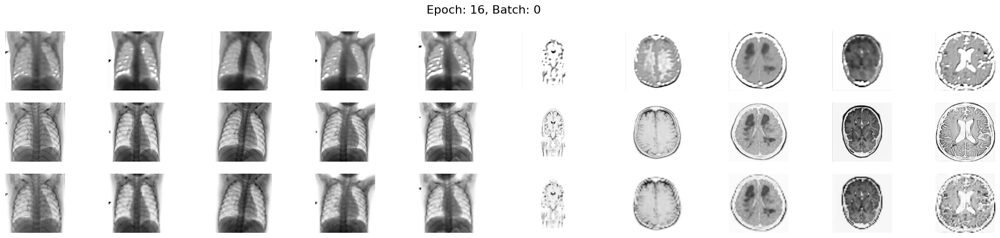

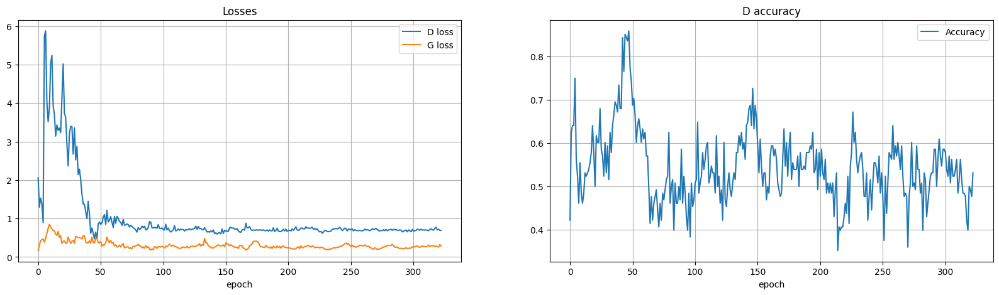

----EPOCH 17-----
0 [D loss: 0.6701,	 acc.: 57.81%]	[G loss: 0.2686]
Execution time: 1.7814974784851074


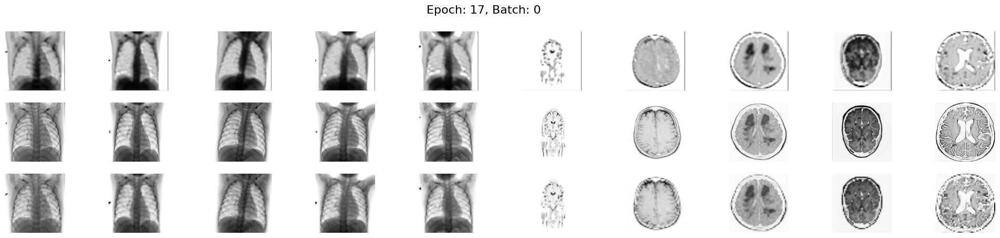

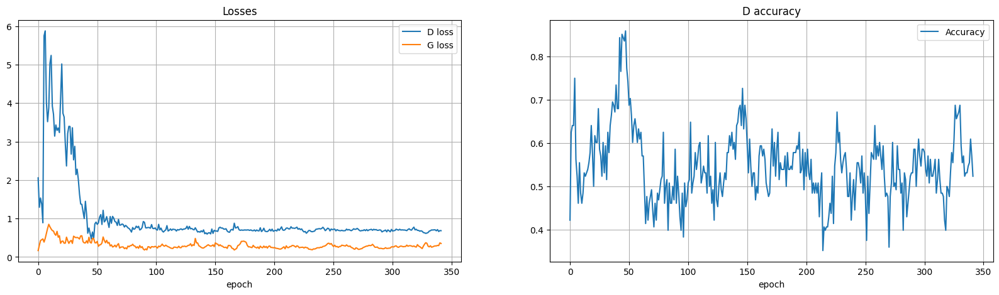

----EPOCH 18-----
0 [D loss: 0.6382,	 acc.: 57.81%]	[G loss: 0.3790]
Execution time: 1.829650640487671


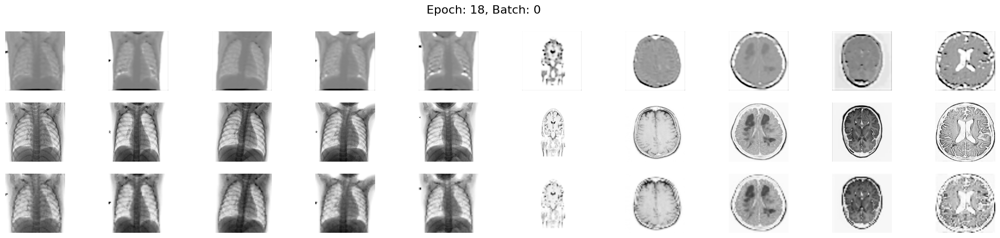

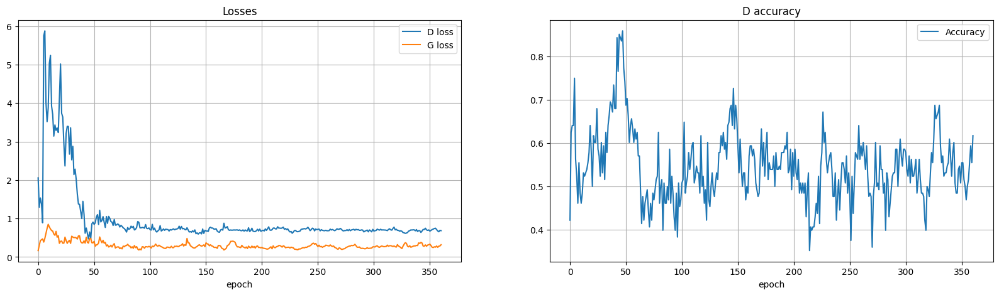

----EPOCH 19-----
0 [D loss: 0.6671,	 acc.: 60.16%]	[G loss: 0.2888]
Execution time: 1.8242278099060059


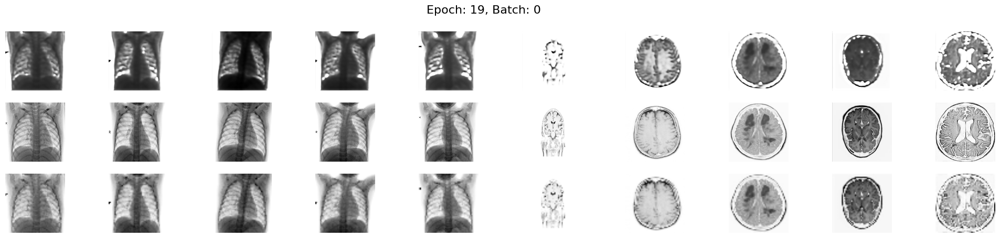

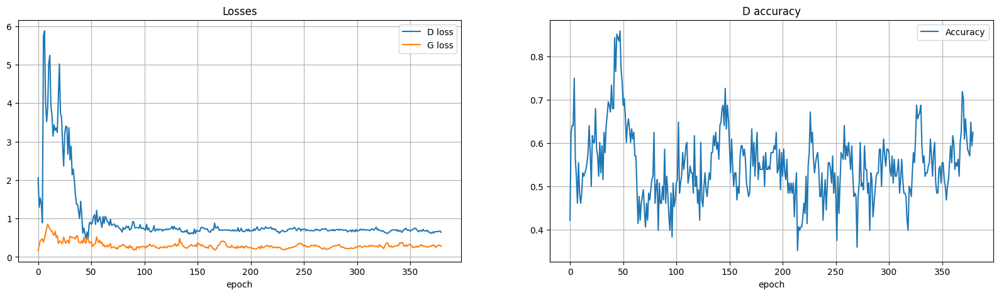

----EPOCH 20-----
0 [D loss: 0.6271,	 acc.: 68.75%]	[G loss: 0.2809]
Execution time: 1.319021224975586


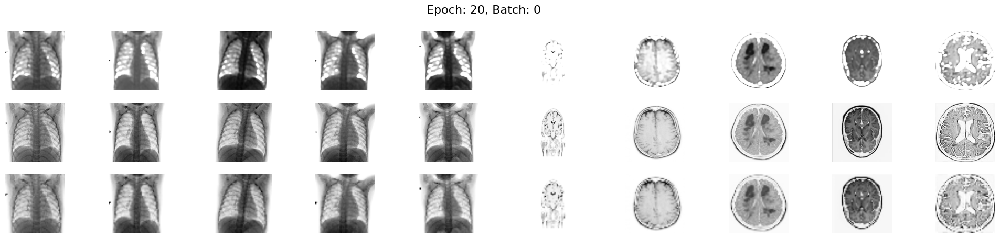

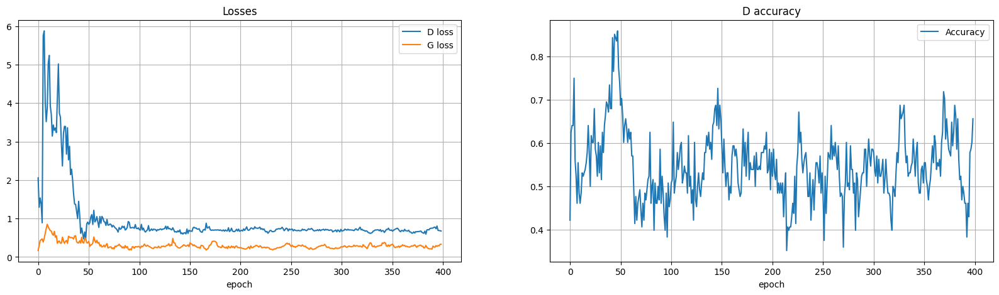

----EPOCH 21-----
0 [D loss: 0.7051,	 acc.: 57.81%]	[G loss: 0.3513]
Execution time: 1.3217334747314453


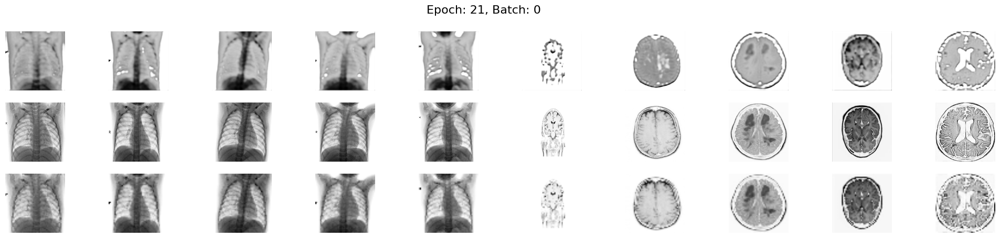

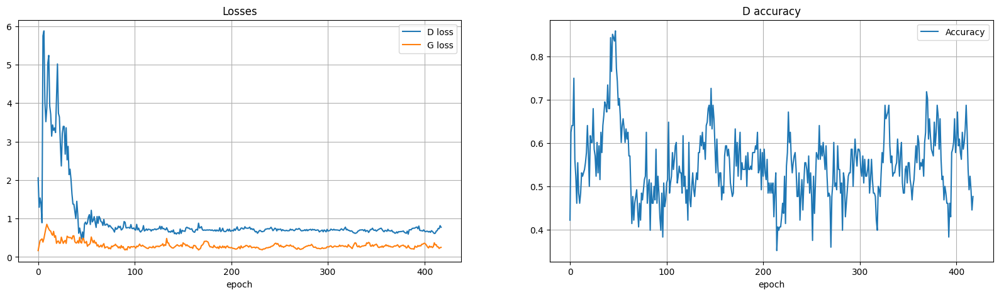

----EPOCH 22-----
0 [D loss: 0.6984,	 acc.: 52.34%]	[G loss: 0.2102]
Execution time: 1.365957498550415


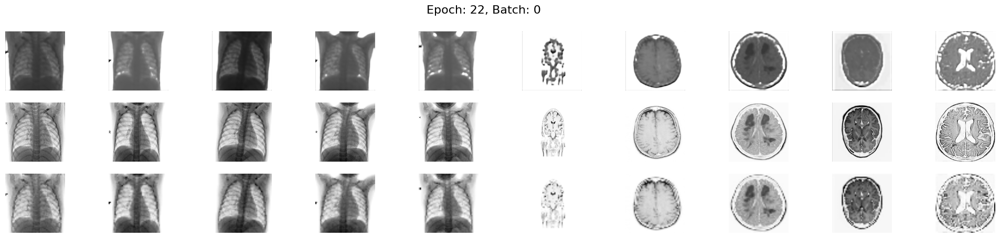

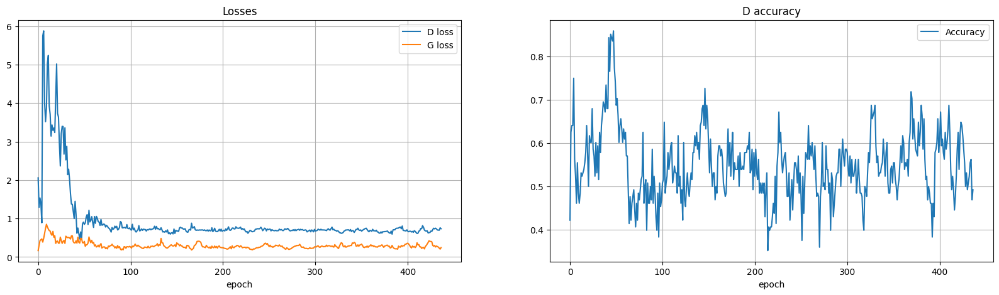

----EPOCH 23-----
0 [D loss: 0.6197,	 acc.: 64.84%]	[G loss: 0.3080]
Execution time: 1.3554210662841797


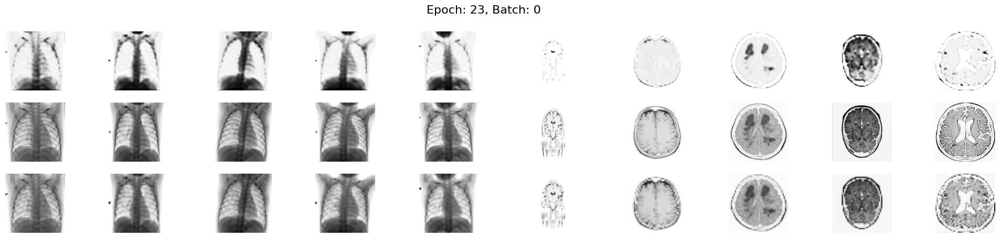

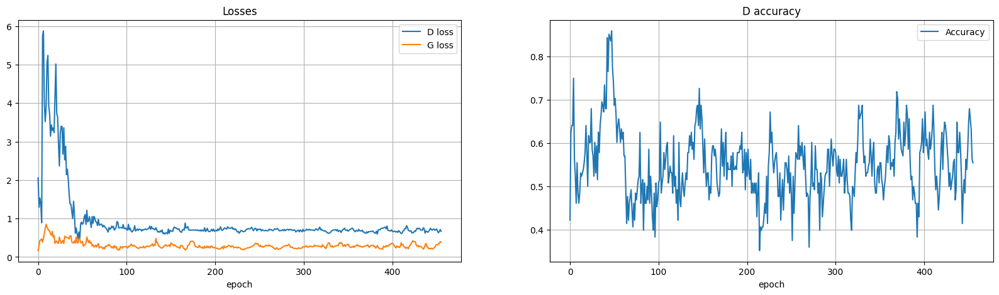

----EPOCH 24-----
0 [D loss: 0.6781,	 acc.: 59.38%]	[G loss: 0.3584]
Execution time: 1.3781561851501465


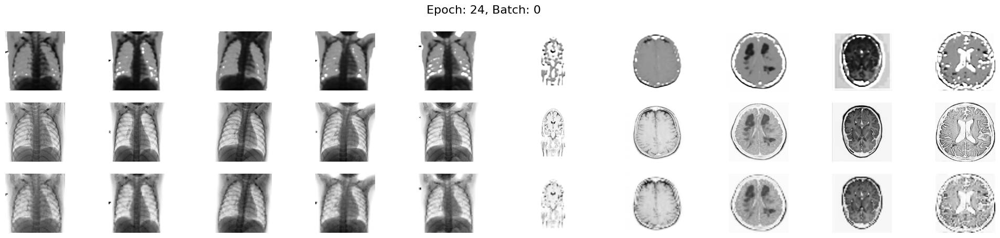

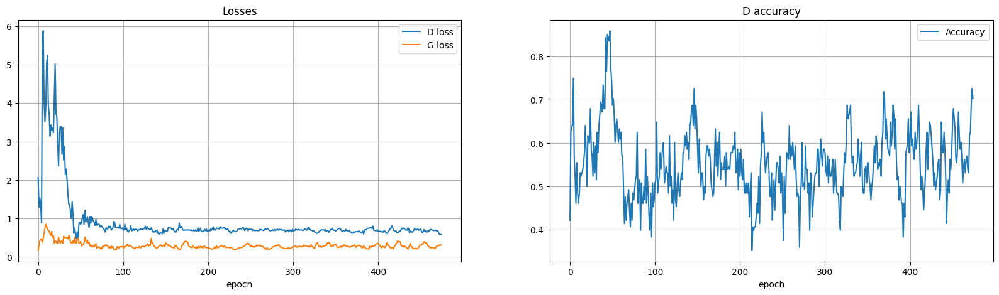

----EPOCH 25-----
0 [D loss: 0.5403,	 acc.: 78.12%]	[G loss: 0.2903]
Execution time: 1.3769760131835938


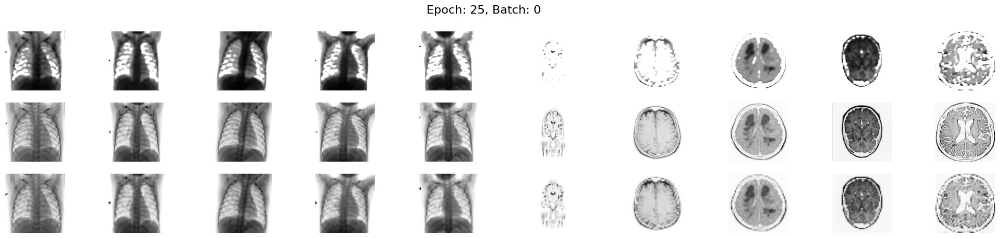

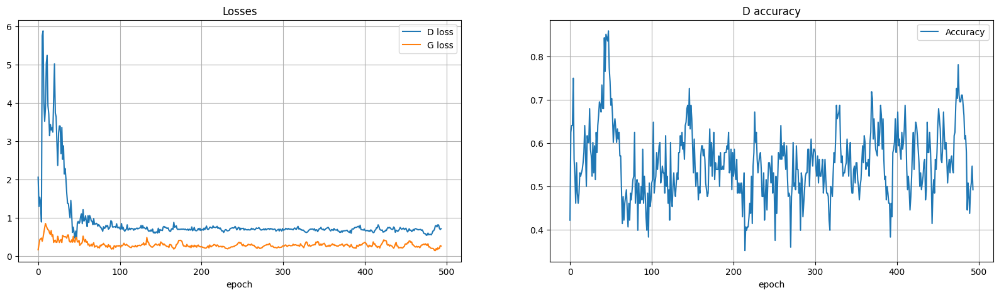

----EPOCH 26-----
0 [D loss: 0.6875,	 acc.: 58.59%]	[G loss: 0.2384]
Execution time: 1.8297650814056396


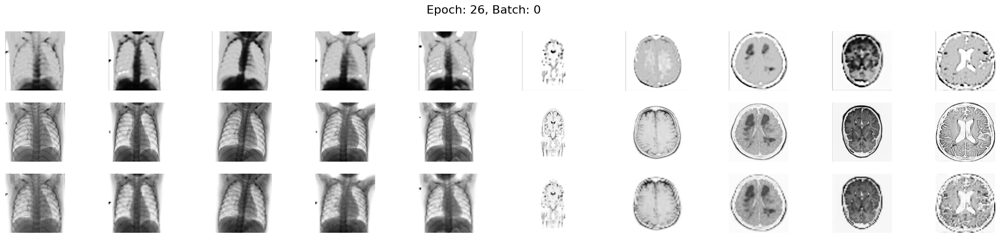

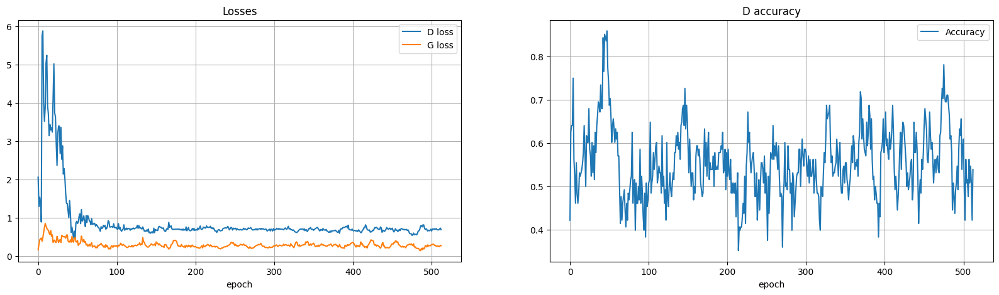

----EPOCH 27-----
0 [D loss: 0.6974,	 acc.: 52.34%]	[G loss: 0.2421]
Execution time: 1.405421495437622


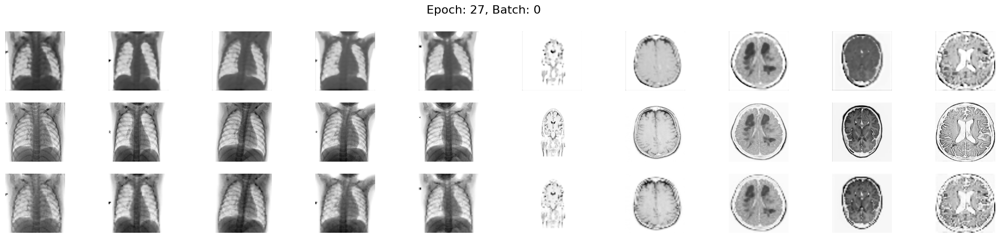

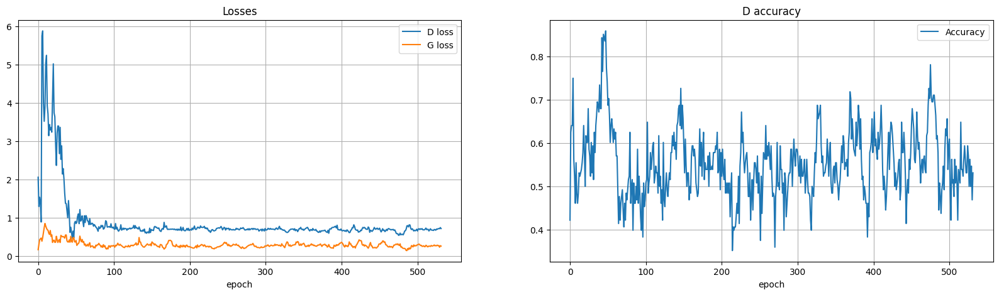

----EPOCH 28-----
0 [D loss: 0.7255,	 acc.: 47.66%]	[G loss: 0.2810]
Execution time: 1.4168131351470947


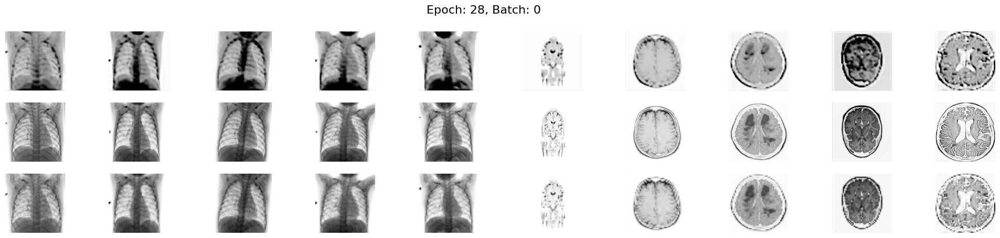

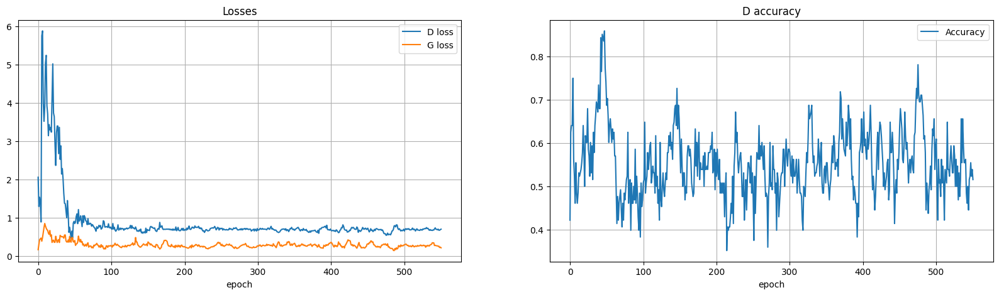

----EPOCH 29-----
0 [D loss: 0.7247,	 acc.: 48.44%]	[G loss: 0.2103]
Execution time: 1.7992327213287354


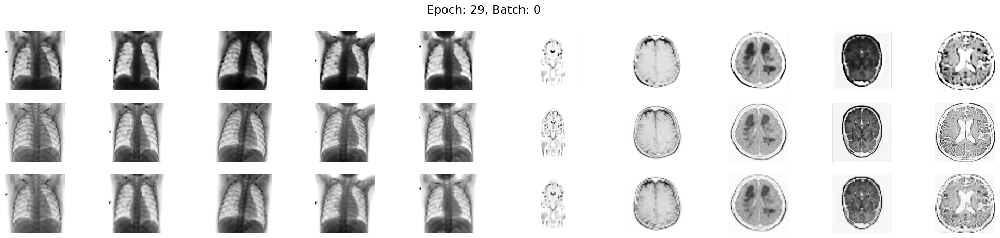

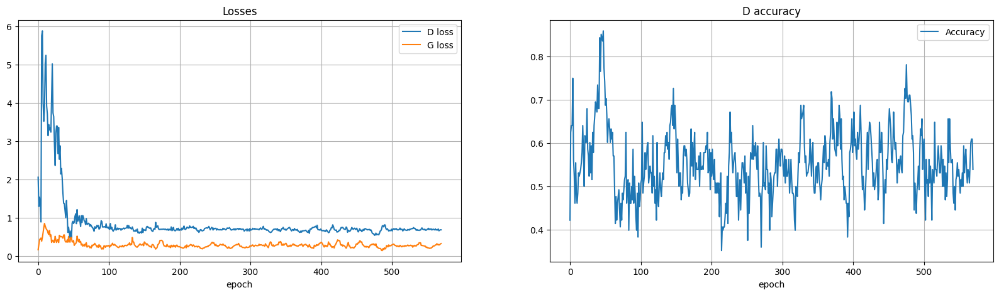

----EPOCH 30-----
0 [D loss: 0.6932,	 acc.: 57.81%]	[G loss: 0.3073]
Execution time: 1.3794963359832764


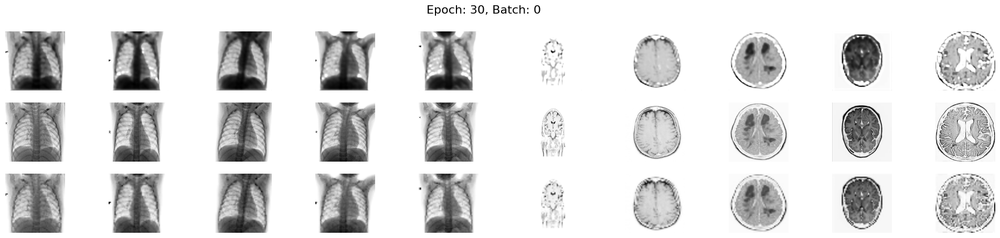

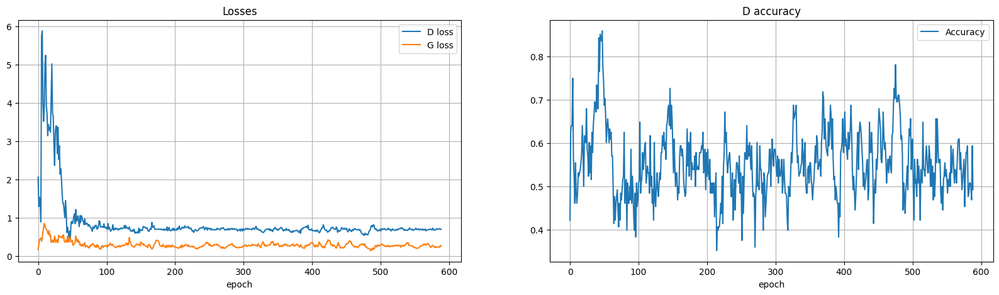

----EPOCH 31-----
0 [D loss: 0.6808,	 acc.: 56.25%]	[G loss: 0.2759]
Execution time: 1.3778836727142334


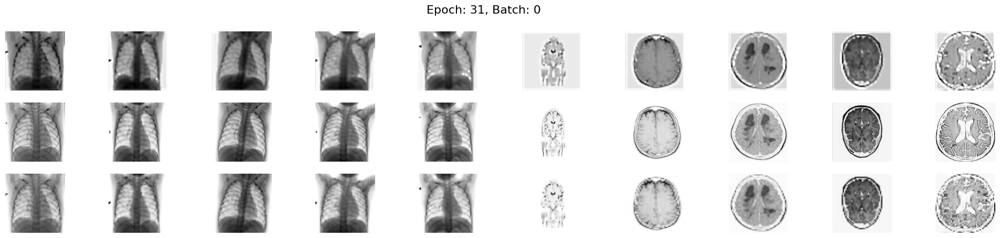

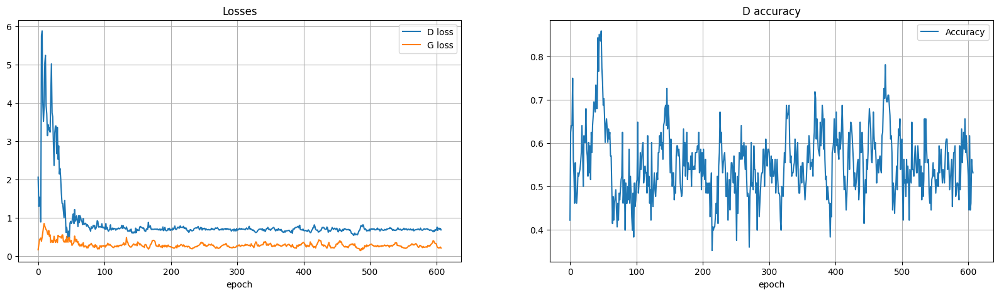

----EPOCH 32-----
0 [D loss: 0.7258,	 acc.: 46.88%]	[G loss: 0.1934]
Execution time: 1.3995647430419922


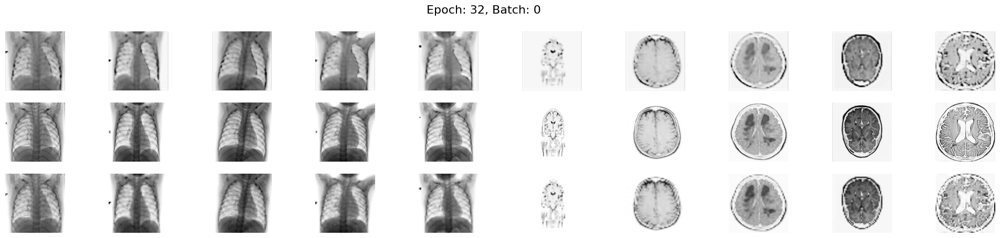

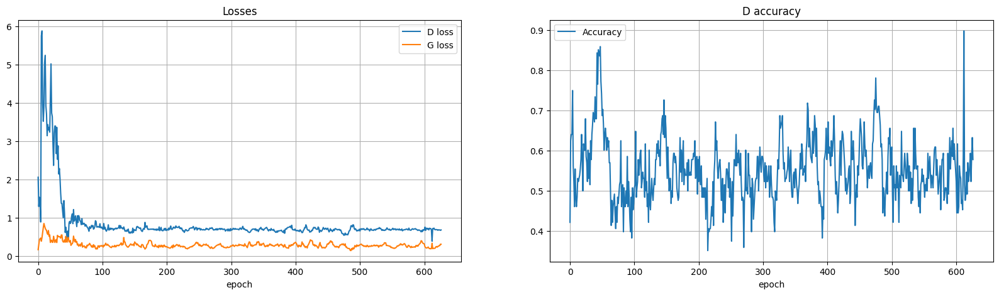

----EPOCH 33-----
0 [D loss: 0.6714,	 acc.: 63.28%]	[G loss: 0.3226]
Execution time: 1.33123779296875


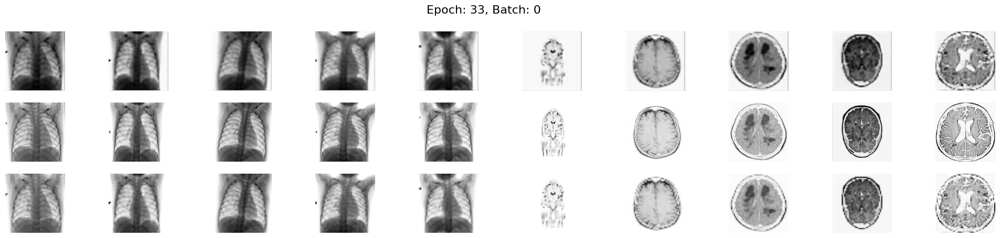

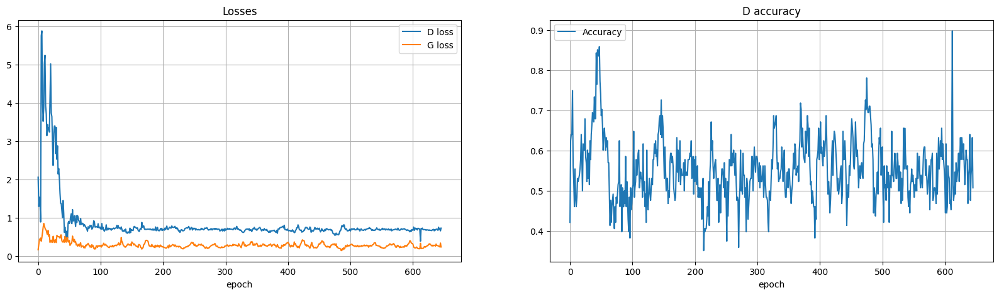

----EPOCH 34-----
0 [D loss: 0.6953,	 acc.: 50.00%]	[G loss: 0.3217]
Execution time: 1.3581221103668213


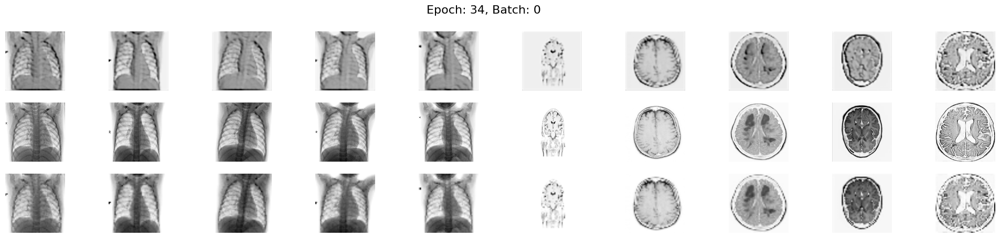

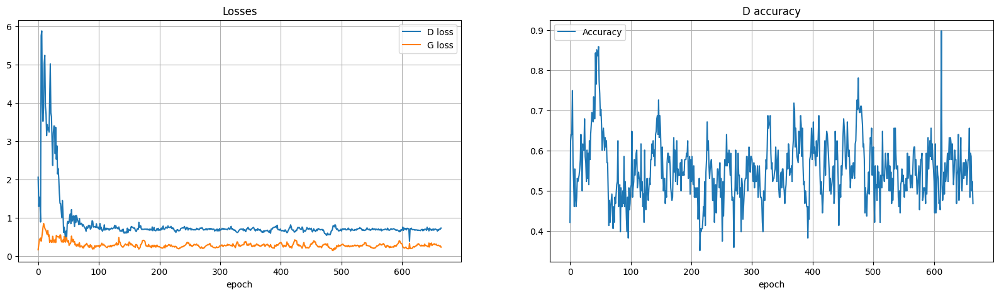

----EPOCH 35-----
0 [D loss: 0.7129,	 acc.: 51.56%]	[G loss: 0.2422]
Execution time: 1.3726789951324463


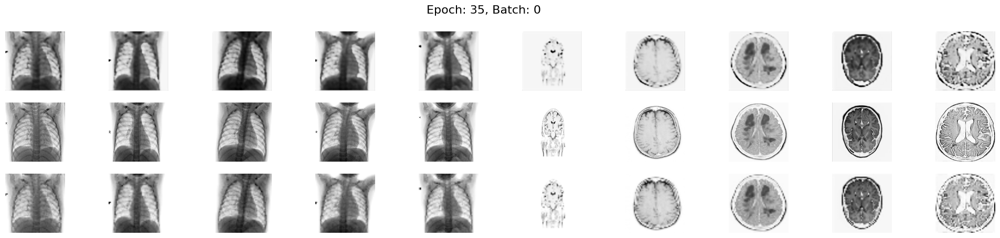

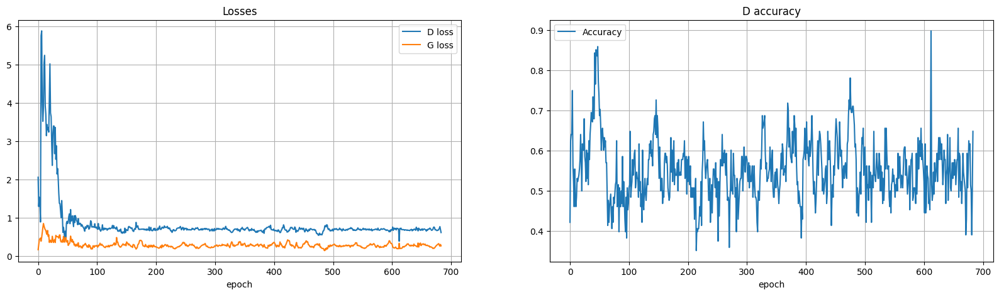

----EPOCH 36-----
0 [D loss: 0.6317,	 acc.: 59.38%]	[G loss: 0.3167]
Execution time: 1.3851051330566406


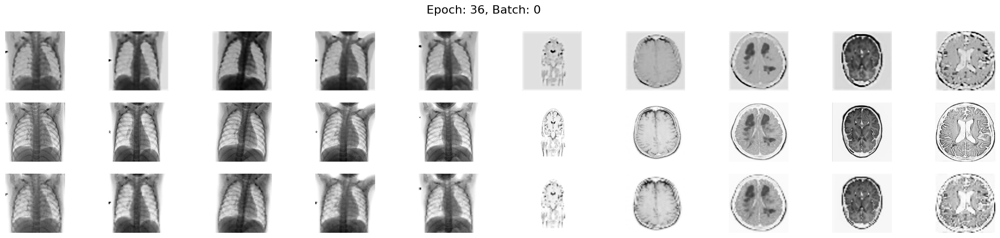

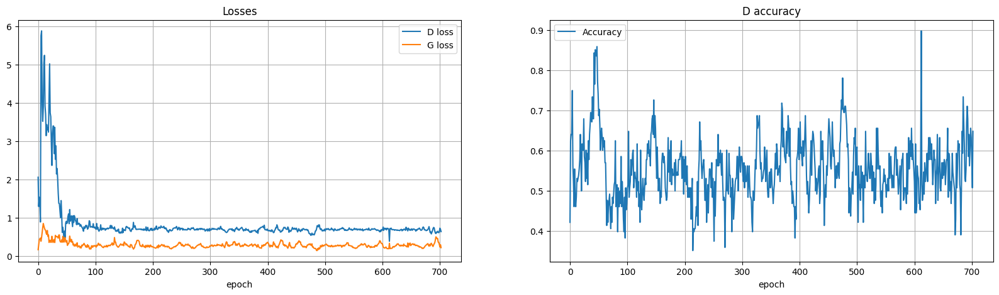

----EPOCH 37-----
0 [D loss: 0.5824,	 acc.: 67.97%]	[G loss: 0.3336]
Execution time: 1.7769312858581543


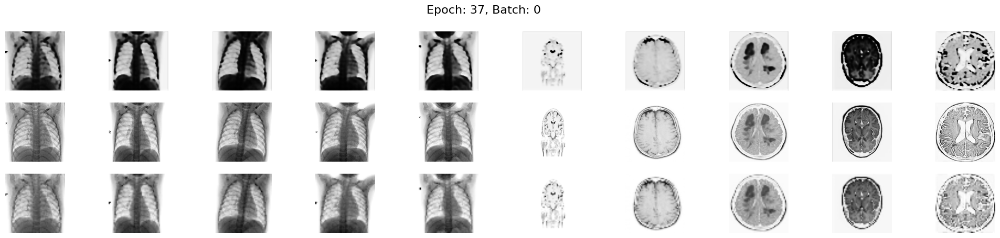

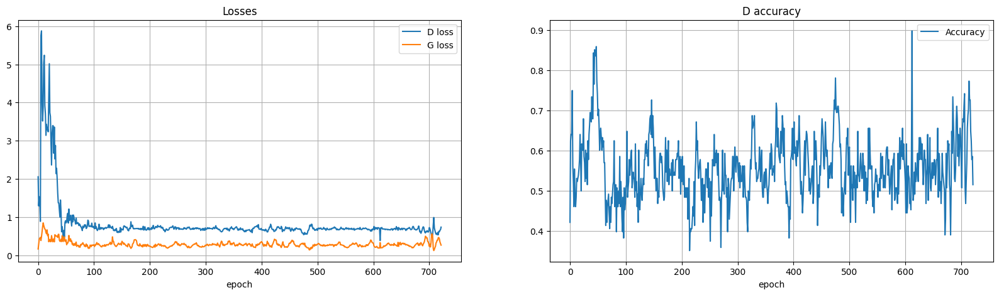

----EPOCH 38-----
0 [D loss: 0.7054,	 acc.: 61.72%]	[G loss: 0.2541]
Execution time: 1.7800250053405762


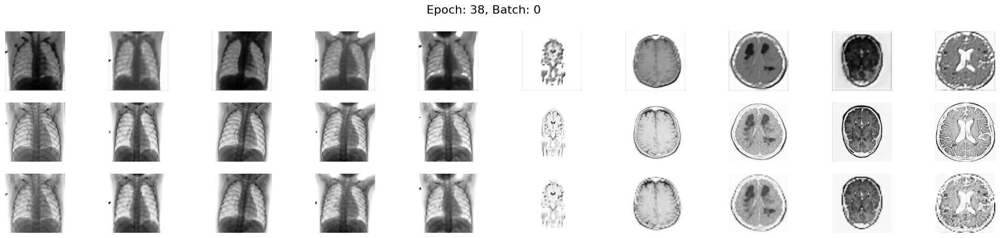

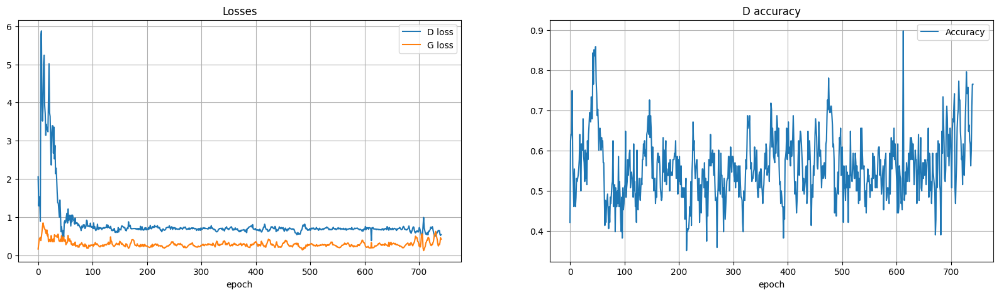

----EPOCH 39-----
0 [D loss: 0.5572,	 acc.: 70.31%]	[G loss: 0.4557]
Execution time: 1.4021210670471191


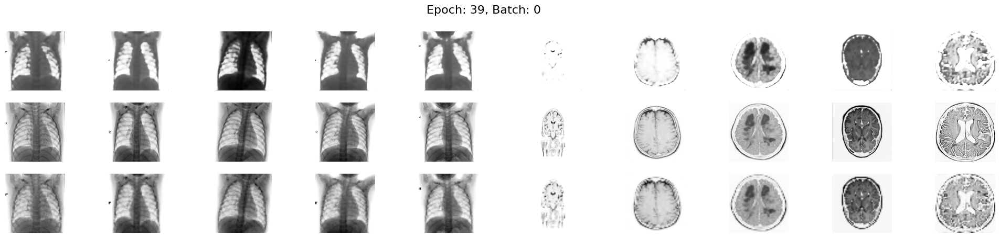

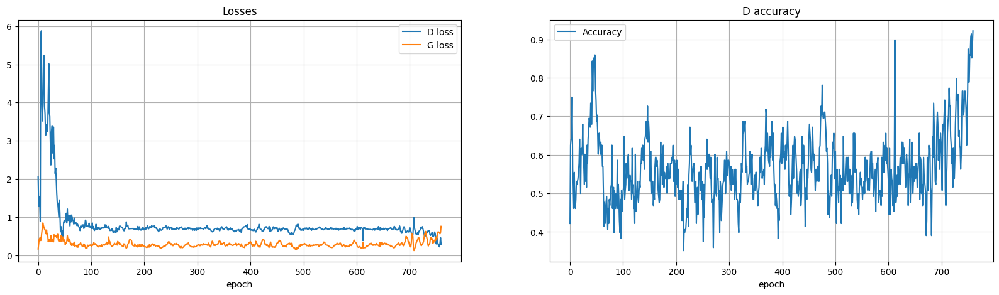

----EPOCH 40-----
0 [D loss: 0.2706,	 acc.: 90.62%]	[G loss: 0.7036]
Execution time: 1.3321726322174072


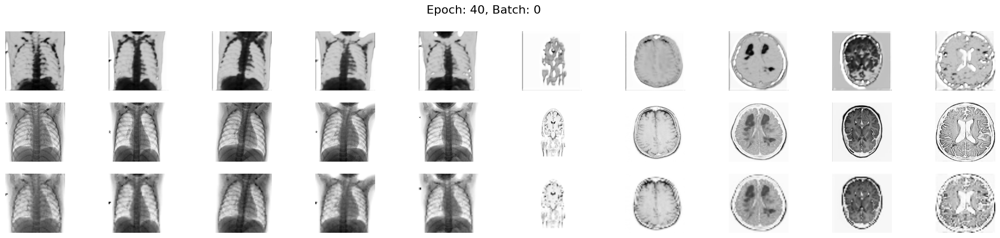

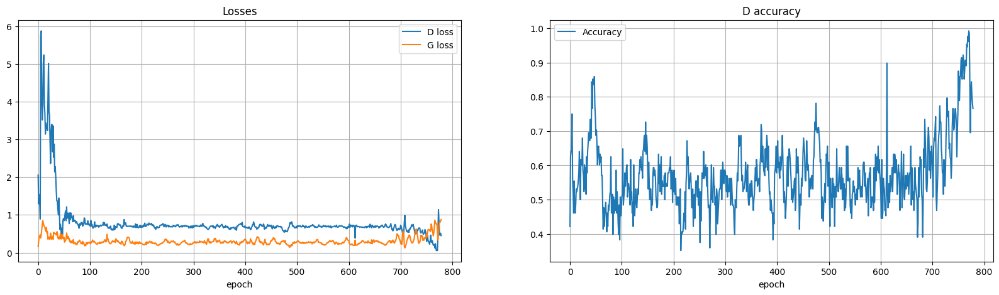

----EPOCH 41-----
0 [D loss: 0.4736,	 acc.: 72.66%]	[G loss: 0.7595]
Execution time: 1.4164550304412842


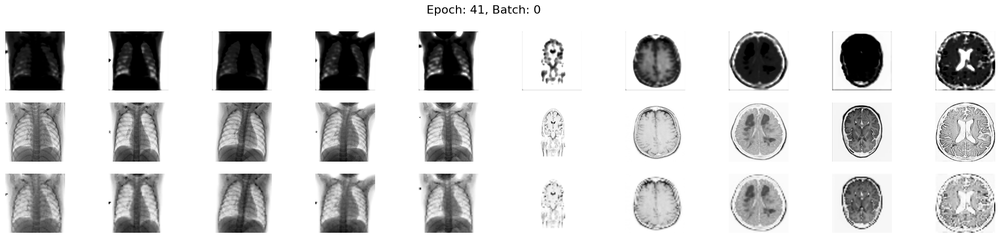

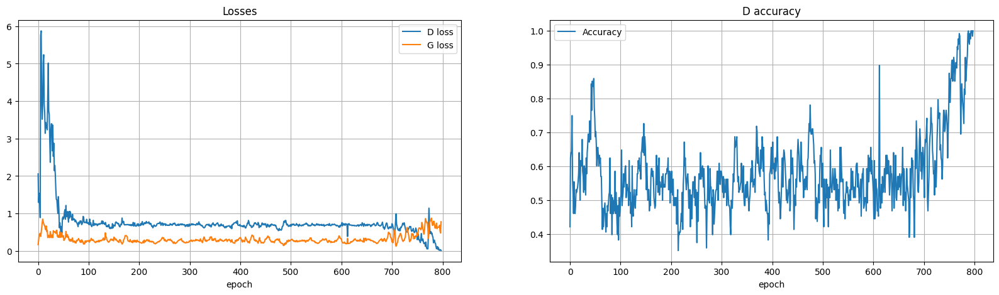

----EPOCH 42-----
0 [D loss: 0.0024,	 acc.: 100.00%]	[G loss: 0.7209]
Execution time: 1.3671863079071045


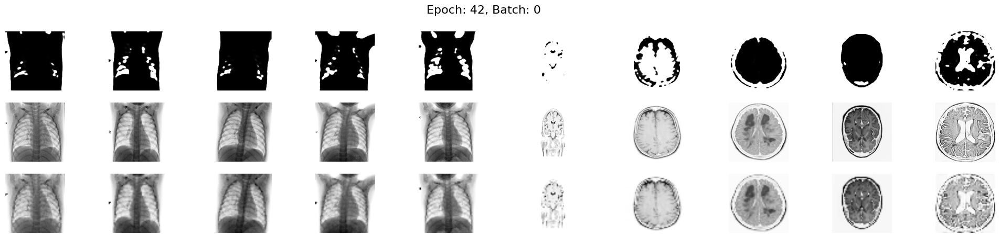

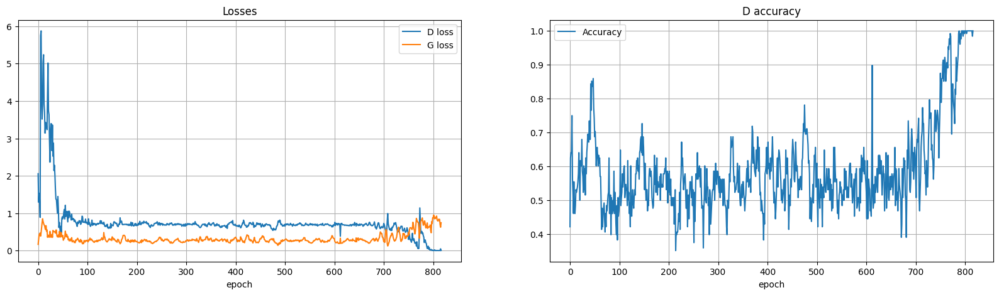

----EPOCH 43-----
0 [D loss: 0.0036,	 acc.: 100.00%]	[G loss: 0.5797]
Execution time: 1.3836705684661865


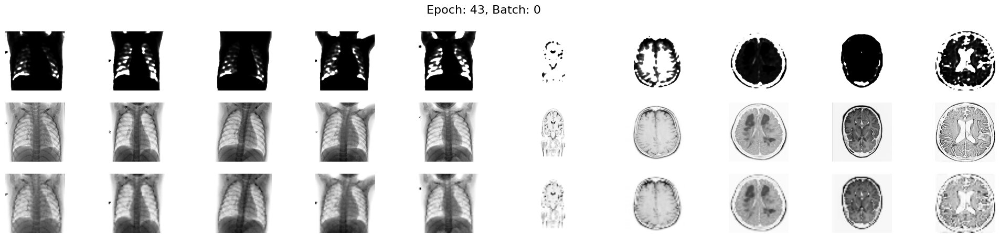

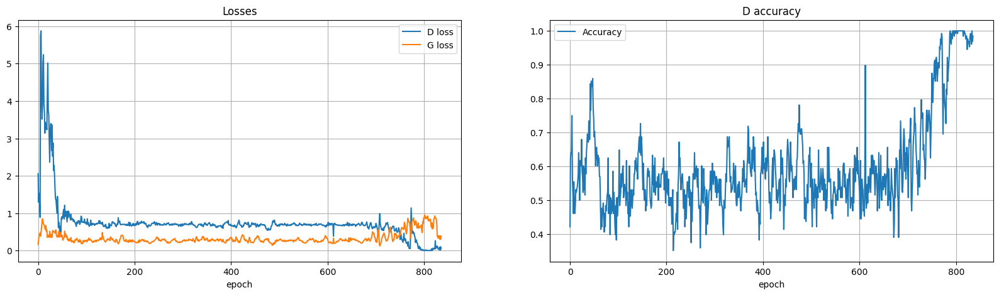

----EPOCH 44-----
0 [D loss: 0.0100,	 acc.: 100.00%]	[G loss: 0.4984]
Execution time: 1.343977689743042


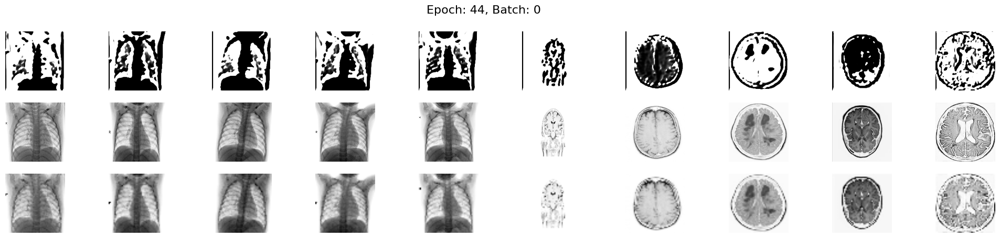

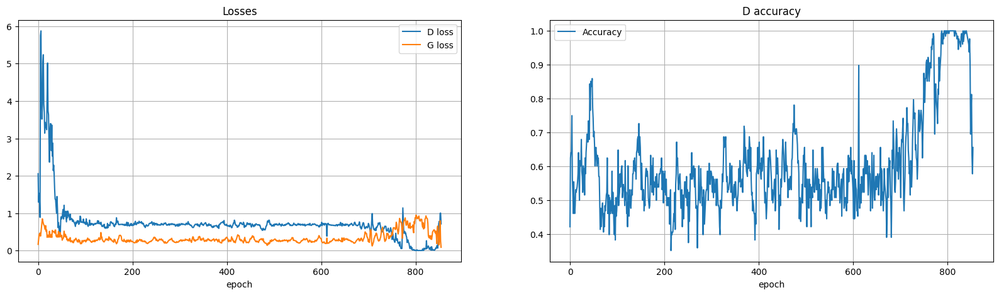

----EPOCH 45-----
0 [D loss: 0.7492,	 acc.: 61.72%]	[G loss: 0.2999]
Execution time: 1.7679226398468018


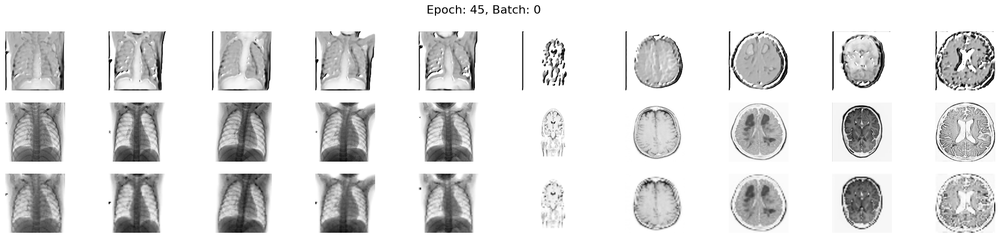

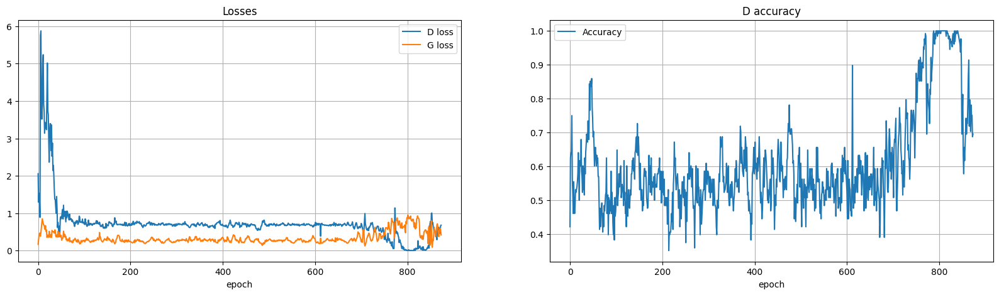

----EPOCH 46-----
0 [D loss: 0.6067,	 acc.: 67.97%]	[G loss: 0.4239]
Execution time: 1.8048040866851807


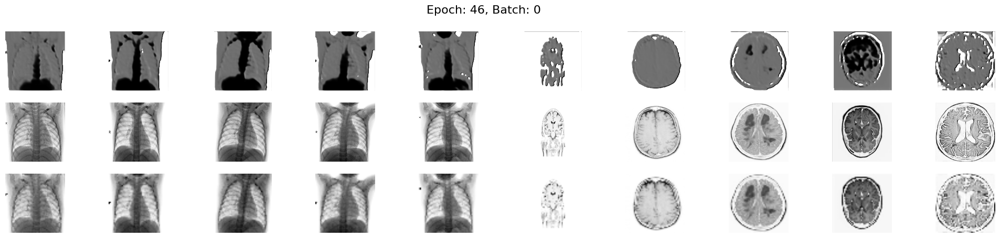

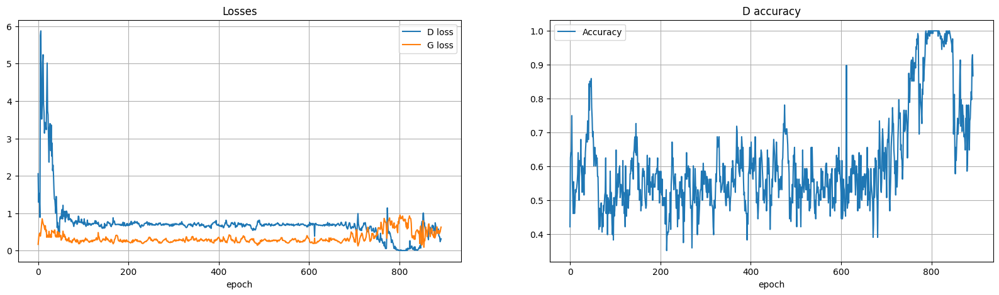

----EPOCH 47-----
0 [D loss: 0.3230,	 acc.: 86.72%]	[G loss: 0.5908]
Execution time: 1.4154081344604492


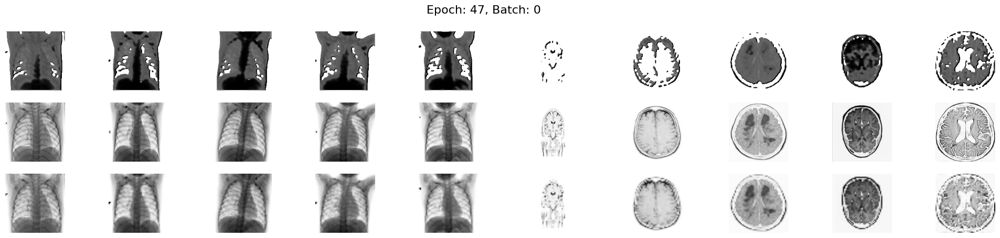

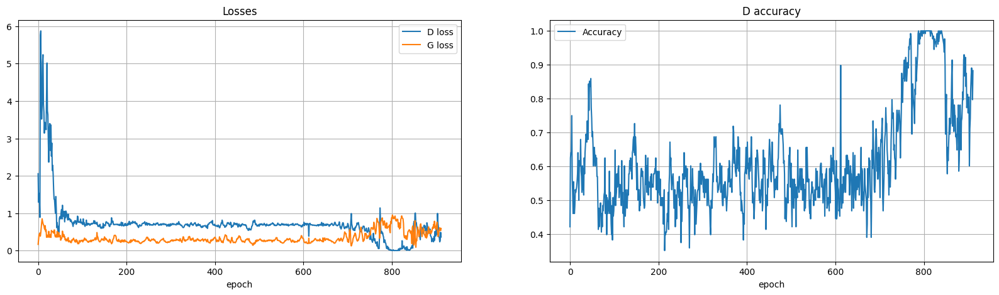

----EPOCH 48-----
0 [D loss: 0.2440,	 acc.: 89.06%]	[G loss: 0.6628]
Execution time: 1.4109084606170654


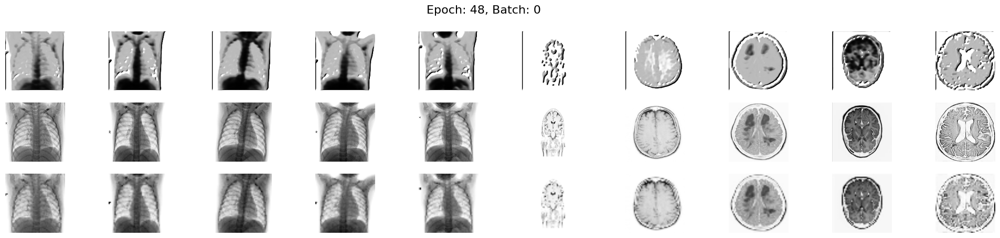

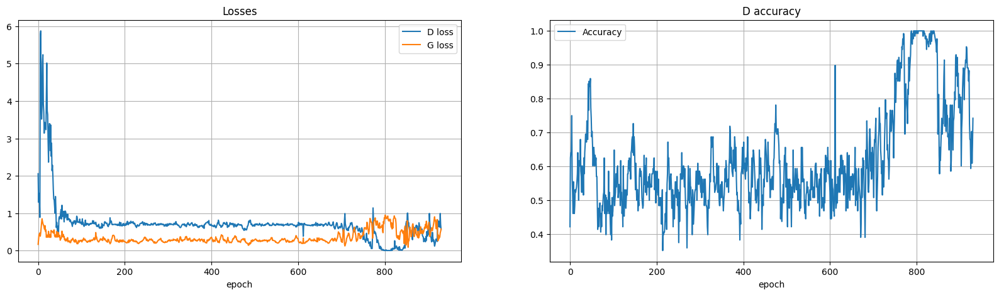

----EPOCH 49-----
0 [D loss: 0.5113,	 acc.: 73.44%]	[G loss: 0.5056]
Execution time: 1.4018900394439697


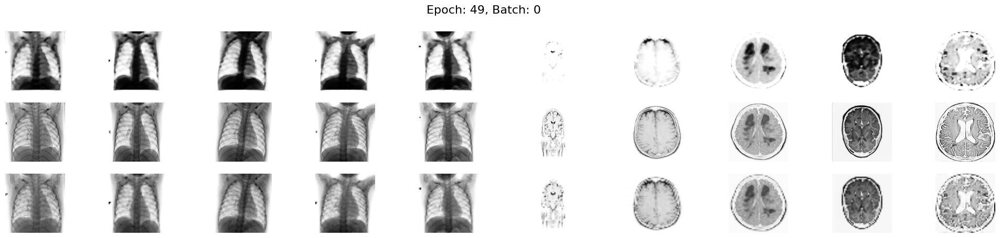

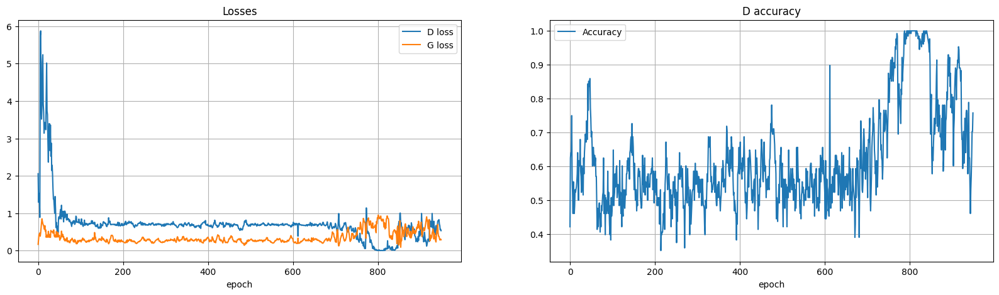

In [ ]:
train(X_train, generator, discriminator, combined, epochs=50, batch_size=64, sample_interval=100)

# Predicciones

Realizamos las predicciones de nuestro modelo.

In [ ]:
img_pred = generator.predict(X_test_low)

10/10 [==============================] - 4s 416ms/step


## Resultados

Esta es una comparación random de 5 imagenes de nuestro conjunto de test. El modelo no es perfecto pero si que es capaz de reconocer contornos y formas además de reconstruir parcialmente las imagenes, los resultados son bastante prometedores.

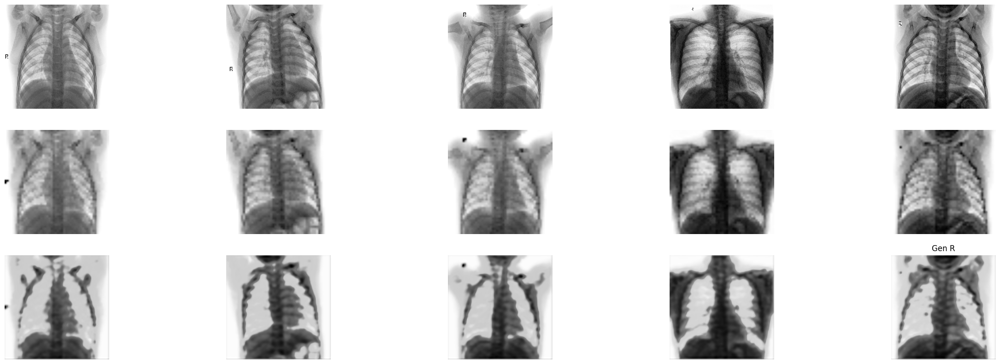

In [ ]:
rand = random.randint(0, 200)

plt.rcParams['figure.figsize'] = [30, 10]
fig, axs = plt.subplots(3, 5)

# High resolution
for i in range(5):
    j = rand+i
    plt.title("High R")
    axs[0,i].imshow(X_test[j],     cmap='Greys')
    plt.title("Low R")
    axs[1,i].imshow(X_test_low[j], cmap='Greys')
    plt.title("Gen R")
    axs[2,i].imshow(img_pred[j],   cmap='Greys')

    axs[0,i].axis('off')
    axs[1,i].axis('off')
    axs[2,i].axis('off')


Y por último mostraremos las 100 primeras imagenes predichas.

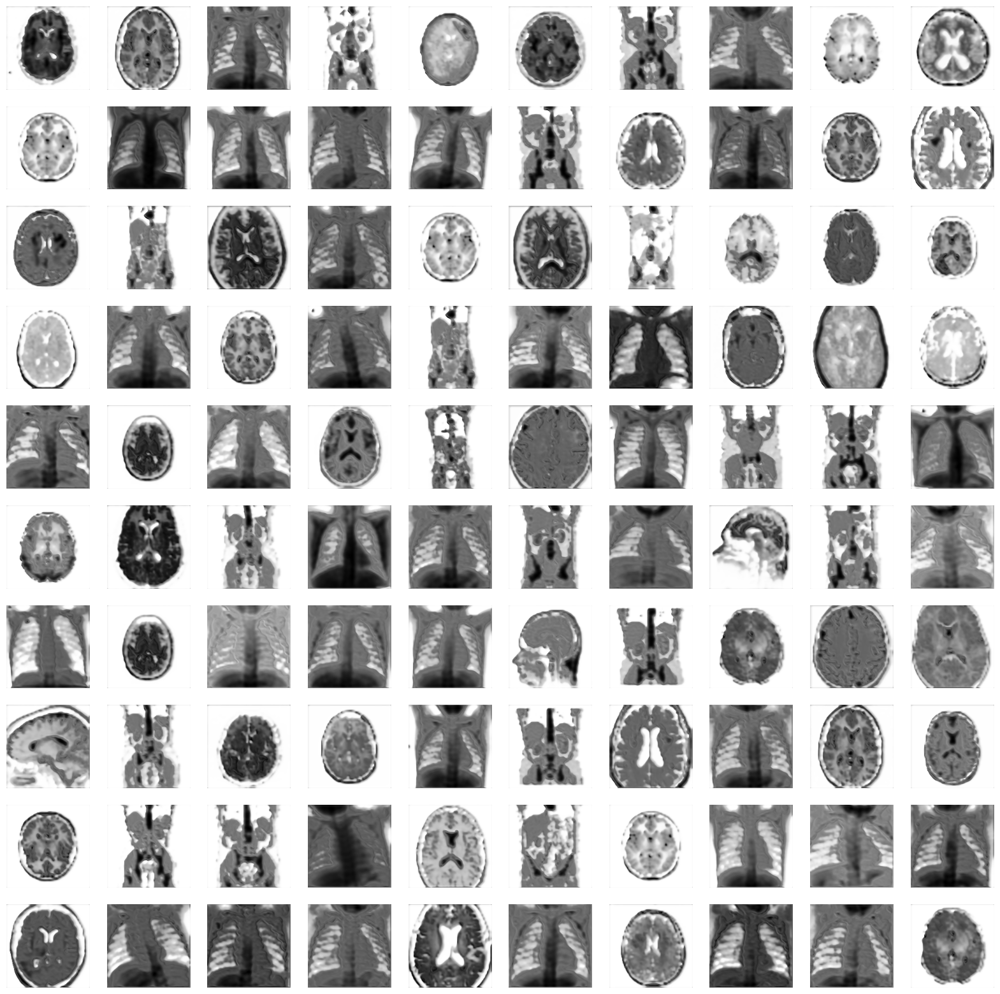

In [ ]:
plt.figure(figsize=(20, 20))

for i in range(100):
    plt.subplot(10, 10, i + 1)
    plt.imshow(img_pred[i], cmap='Greys')
    plt.axis("off")

# Conclusión

Los resultados no han sido perfectos pero tampoco han sido malos. Hay alguna imagen donde se podría decir que nuestro modelo ha conseguido igualar o incluso mejorar a las de baja calidad, es posible que perfeccionando la arquitectura y mejorando las funciones de perdida los resultados sean mejores.

También, hemos intentado mejorar los resultados aplicando data augmentation, no vimos una mejora significativa y finalmente decidimos eliminarla del cuaderno. A parte del data augmentation, también probamos a cambiar el dataset, funciones de activación, y a incrementar el número de epochs, llegando a ejecutar trains de más de 80.

Sin embargo, para ser un proyecto de 2 semanas de duración estamos muy contentos con los resultados obtenidos.